Available layers: ['Alento', 'Astico', 'Crati', 'Sieve', 'Tevere', 'Volturno']


<Axes: >

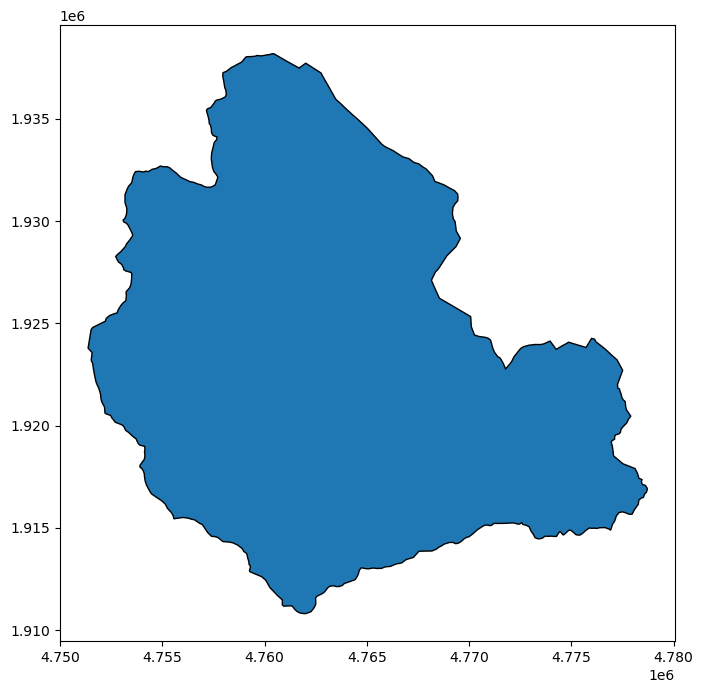

In [8]:
# Step 1: Import required libraries
import geopandas as gpd
import fiona  # 👈 This line was missing

# Step 2: Set the file path to your GPKG
file_path = '/Users/ghulamabbaszafari/Downloads/reproj/basins_3035.gpkg'

# Step 3: List all layers in the GeoPackage
layers = fiona.listlayers(file_path)
print("Available layers:", layers)

# Step 4: Load the first layer (or pick one from the list)
gdf = gpd.read_file(file_path, layer=layers[0])

# Step 5: Preview the data
gdf.head()

# Step 6: Plot the data
gdf.plot(figsize=(10, 8), edgecolor='black')



/var/folders/mz/wk_rk1fs2m96vphdr62m5bym0000gn/T/grass8-ghulamabbaszafari-41561/ipykernel_43483/1325785610.py:75: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centroid = tevere_web.geometry.unary_union.centroid
/var/folders/mz/wk_rk1fs2m96vphdr62m5bym0000gn/T/grass8-ghulamabbaszafari-41561/ipykernel_43483/1325785610.py:113: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Map saved successfully to: /Users/ghulamabbaszafari/Desktop/tevere_study_area_thesis_layout_final.png


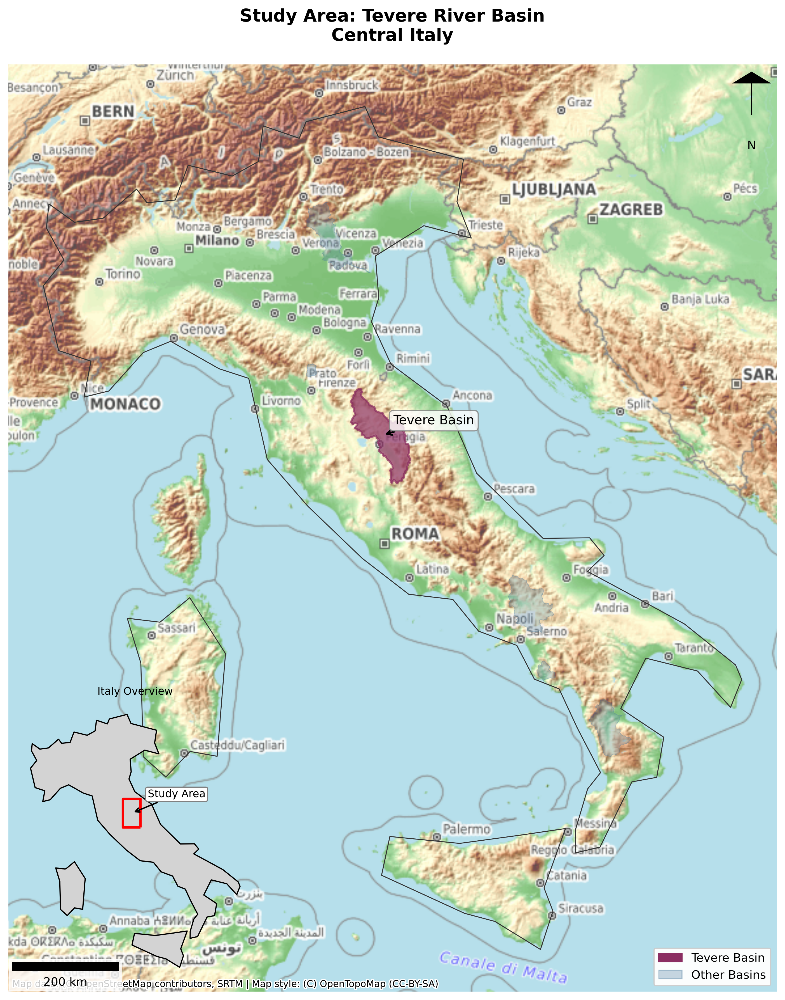

In [10]:
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.patches import Patch
from shapely.geometry import box

# --- File Paths ---
basins_path = "/Users/ghulamabbaszafari/Desktop/glance_basins_italy.gpkg"
countries_path = "/Users/ghulamabbaszafari/Downloads/ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp"

# --- Data Loading ---
layer_info = gpd.list_layers(basins_path)
layer_names = layer_info['name'].tolist()

all_basins = gpd.GeoDataFrame()
for layer in layer_names:
    try:
        df = gpd.read_file(basins_path, layer=layer)
        df['basin_name'] = layer
        all_basins = gpd.pd.concat([all_basins, df])
    except Exception as e:
        print(f"Error loading layer {layer}: {str(e)}")
        continue

tevere = all_basins[all_basins['basin_name'] == 'Tevere']
other_basins = all_basins[all_basins['basin_name'] != 'Tevere']
italy = gpd.read_file(countries_path).query("ADMIN == 'Italy'")

# --- Projection ---
crs_web = 3857
tevere_web = tevere.to_crs(crs_web)
other_web = other_basins.to_crs(crs_web)
italy_web = italy.to_crs(crs_web)

# --- Main Figure ---
plt.style.use('default')
fig, ax = plt.subplots(figsize=(10, 12), dpi=300)
fig.patch.set_facecolor('white')
ax.set_facecolor('white')

# Colors
basin_color = '#8B2E62'
other_color = '#4A7B9D'
border_color = '#333333'

# --- Main Map Plot ---
italy_web.boundary.plot(ax=ax, color=border_color, linewidth=0.8, zorder=1)
if not other_web.empty:
    other_web.plot(ax=ax, color=other_color, alpha=0.3, edgecolor=other_color, linewidth=0.5)
tevere_web.plot(ax=ax, color=basin_color, alpha=0.7, edgecolor=basin_color, linewidth=1.5)
ctx.add_basemap(ax, source=ctx.providers.OpenTopoMap, alpha=0.7)

# --- Map Elements ---
ax.add_artist(ScaleBar(1, location='lower left', box_alpha=0.8))

# North arrow
north_ax = inset_axes(ax, width="5%", height="5%", loc='upper right')
north_ax.arrow(0.5, 0.5, 0, 0.3, head_width=0.2, head_length=0.1, fc='k', ec='k')
north_ax.set_axis_off()
north_ax.text(0.5, 0.2, 'N', ha='center', va='center', fontsize=10)

# --- Legend ---
legend_elements = [
    Patch(facecolor=basin_color, edgecolor=basin_color, label='Tevere Basin'),
    Patch(facecolor=other_color, edgecolor=other_color, alpha=0.3, label='Other Basins')
]
ax.legend(handles=legend_elements, loc='lower right', framealpha=0.95)

# --- Title ---
ax.set_title("Study Area: Tevere River Basin\nCentral Italy", fontsize=15, fontweight='bold', pad=20)

# --- Annotation Arrow to Tevere ---
centroid = tevere_web.geometry.unary_union.centroid
text_x, text_y = centroid.x + 20000, centroid.y + 20000
ax.annotate(
    "Tevere Basin",
    xy=(centroid.x, centroid.y),
    xytext=(text_x, text_y),
    arrowprops=dict(arrowstyle="->", lw=1.5, color="black"),
    fontsize=11,
    bbox=dict(boxstyle="round,pad=0.3", facecolor="white", edgecolor="gray", alpha=0.8)
)

# --- Inset Map (Overview) ---
inset = inset_axes(ax, width="30%", height="30%", loc='lower left', borderpad=1)
italy_web.plot(ax=inset, color='lightgray', edgecolor='black')

# Tevere location bounding box in inset
tevere_bounds = tevere_web.total_bounds
tevere_box = box(*tevere_bounds)
tevere_gdf_box = gpd.GeoDataFrame(geometry=[tevere_box], crs=crs_web)
tevere_gdf_box.boundary.plot(ax=inset, edgecolor='red', linewidth=2)

# Add arrow pointing to Tevere box in the inset map
inset.annotate(
    "Study Area",
    xy=tevere_box.centroid.coords[0],      # Arrow points to the center of the box
    xytext=(tevere_box.centroid.x + 1e5, tevere_box.centroid.y + 1e5),  # Offset text
    arrowprops=dict(arrowstyle="->", color='black', lw=1.2),
    fontsize=9,
    bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='gray')
)

inset.set_xticks([])
inset.set_yticks([])
inset.set_title("Italy Overview", fontsize=9)
inset.set_axis_off()

# --- Final Layout ---
ax.axis('off')
plt.tight_layout()

# --- Save ---
output_path = "/Users/ghulamabbaszafari/Desktop/tevere_study_area_thesis_layout_final.png"
plt.savefig(output_path, bbox_inches='tight', dpi=300, facecolor='white')
print(f"Map saved successfully to: {output_path}")
plt.show()



In [8]:
# Step 1: Import libraries (if not already done)
import geopandas as gpd
import fiona

# Step 2: Set file path
file_path = '/Users/ghulamabbaszafari/Downloads/glance_basins_italy.gpkg'

# Step 3: List all available layers
layers = fiona.listlayers(file_path)
print("Available layers:", layers)

# Step 4: Read all layers into a dictionary
gdfs = {layer: gpd.read_file(file_path, layer=layer) for layer in layers}

# Step 5: Example – Show head of each GeoDataFrame
for name, gdf in gdfs.items():
    print(f"--- {name} ---")
    display(gdf.head())


Available layers: ['Alento', 'Astico', 'Crati', 'Sieve', 'Tevere', 'Volturno']
--- Alento ---


,DGC_CODICE,ID_BACINO,NOME_BAC,NOME_CORSO,FOGLIO_IGM,ORDINE,CODIFICA,AUTORITA,area,geometry
0,8.0,0,ALENTO,FIUME ALENTO,NAPOLI,1,None,ADB SINISTRA SELE,416.286,"POLYGON ((4760422.659 1938205.593, 4761071.536..."


--- Astico ---


,DGC_CODICE,ID_BACINO,NOME_BAC,BACINO_PRI,NOME_CORSO,FOGLIO_IGM,ORDINE,CODIFICA,AUTORITA,geometry
0,5.0,0,BACCHIGLIONE,BRENTA,FIUME BACCHIGLIONE,VENEZIA,2,None,ADB ALTO ADRIATICO,"POLYGON ((4412481.232 2513951.701, 4412477.796..."


--- Crati ---


,DGC_CODICE,ID_BACINO,NOME_BAC,NOME_CORSO,FOGLIO_IGM,ORDINE,CODIFICA,AUTORITA,area,geometry
0,2.0,0,CRATI,FIUME CRATI,COSENZA,1,None,ARPA CALABRIA,2449.694,"POLYGON ((4838911.763 1871010.234, 4839038.649..."


--- Sieve ---


,DN,geometry
0,1,"POLYGON ((4423073.322 2332676.438, 4423093.364..."


--- Tevere ---


,ET_SOURCE,AREA,ID,nome_stazi,OUTPUT (MI,OUTPUT (MA,OUTPUT (RA,OUTPUT (ME,OUTPUT (Q0,Perimetro,...,GridID,NUM_SUB,X_CENTROID,Y_CENTROID,Nodi,CNmedio,cat,layer,path,geometry
0,Pte Nuovo,4.145273e+09,23.0,ponte nuovo di torgiano,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,None,NaN,NaN,ponte_nuovo_torgiano,C:/Users/m.dionigi/Desktop/delimitazione sotto...,"POLYGON ((4480881.403 2269881.9, 4480804.174 2..."


--- Volturno ---


,LON,LAT,Input_FID,Area,geometry
0,14.628684,41.3102,645,1.024513e+08,"POLYGON ((4709670.344 2056180.427, 4709731.657..."


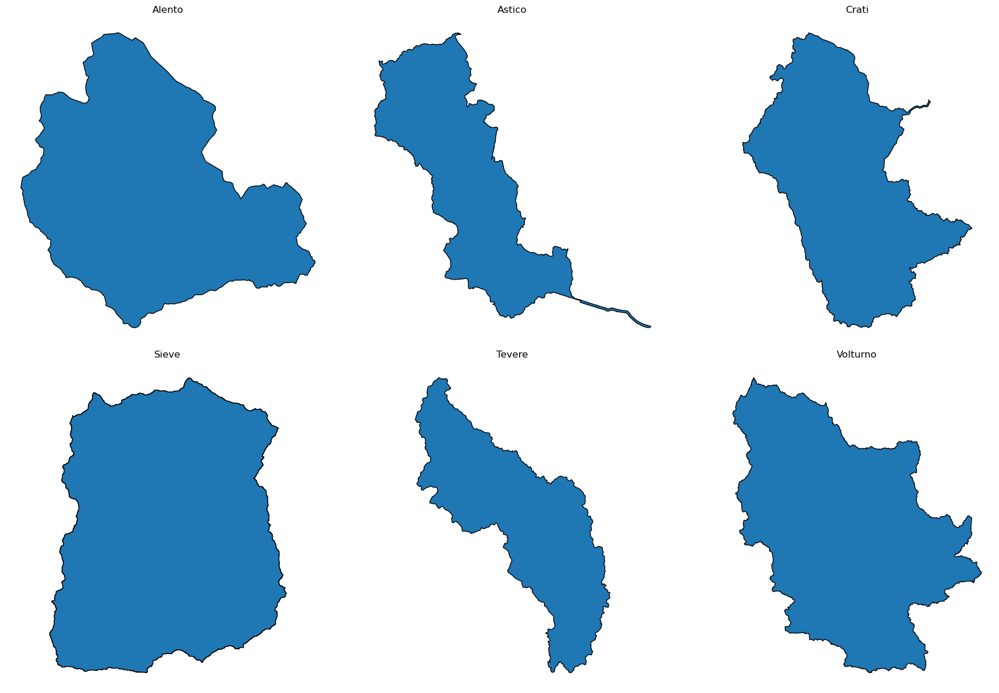

In [9]:
import matplotlib.pyplot as plt

# Plot all layers on separate subplots
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(18, 12))
axs = axs.flatten()

for ax, (name, gdf) in zip(axs, gdfs.items()):
    gdf.plot(ax=ax, edgecolor='black')
    ax.set_title(name)
    ax.axis('off')

plt.tight_layout()
plt.show()


In [6]:
import geopandas as gpd
import fiona
import os

# Step 1: Input GPKG path
input_path = '/Users/ghulamabbaszafari/Downloads/glance_basins_italy.gpkg'

# Step 2: Output GPKG file (inside the "reproj" folder)
output_dir = '/Users/ghulamabbaszafari/Downloads/reproj'
output_file = os.path.join(output_dir, 'basins_3035.gpkg')

# Ensure the output directory exists
os.makedirs(output_dir, exist_ok=True)

# Step 3: List all layers
layers = fiona.listlayers(input_path)
print("Available layers:", layers)

# Step 4: Load and reproject if needed
gdfs_reprojected = {}
for layer in layers:
    gdf = gpd.read_file(input_path, layer=layer)
    if gdf.crs and gdf.crs.to_epsg() == 3035:
        print(f"{layer} already in EPSG:3035.")
        gdfs_reprojected[layer] = gdf
    else:
        gdf = gdf.to_crs(epsg=3035)
        print(f"{layer} reprojected to EPSG:3035.")
        gdfs_reprojected[layer] = gdf

# Step 5: Write all layers to a new GeoPackage
for name, gdf in gdfs_reprojected.items():
    gdf.to_file(output_file, layer=name, driver="GPKG")
    print(f"✔️ Saved layer: {name}")

print(f"\n✅ All layers saved to: {output_file}")


Available layers: ['Alento', 'Astico', 'Crati', 'Sieve', 'Tevere', 'Volturno']
Alento already in EPSG:3035.
Astico already in EPSG:3035.
Crati already in EPSG:3035.
Sieve already in EPSG:3035.
Tevere already in EPSG:3035.
Volturno already in EPSG:3035.
✔️ Saved layer: Alento
✔️ Saved layer: Astico
✔️ Saved layer: Crati
✔️ Saved layer: Sieve
✔️ Saved layer: Tevere
✔️ Saved layer: Volturno

✅ All layers saved to: /Users/ghulamabbaszafari/Downloads/reproj/basins_3035.gpkg


In [13]:
import rasterio
import numpy as np

def inspect_tif_file(file_path):
    """Inspect and display key properties of a TIFF file"""
    print(f"\n{'='*50}\nInspecting TIFF file: {file_path}\n{'='*50}")
    
    try:
        with rasterio.open(file_path) as src:
            # Basic file information
            print("\nBASIC INFORMATION:")
            print(f"Driver: {src.driver}")
            print(f"File name: {src.name}")
            print(f"Number of bands: {src.count}")
            print(f"Width: {src.width} pixels")
            print(f"Height: {src.height} pixels")
            
            # Coordinate system and georeferencing
            print("\nCOORDINATE SYSTEM:")
            print(f"CRS: {src.crs}")
            print(f"Transform: {src.transform}")
            print(f"Bounds: {src.bounds}")
            
            # Data characteristics
            print("\nDATA CHARACTERISTICS:")
            data = src.read(1)
            print(f"Data type: {data.dtype}")
            print(f"Unique values: {np.unique(data)}")
            print(f"Minimum value: {np.min(data)}")
            print(f"Maximum value: {np.max(data)}")
            print(f"NoData value: {src.nodata}")
            
            # Band information
            print("\nBAND INFORMATION:")
            for i in range(1, src.count + 1):
                print(f"\nBand {i}:")
                band = src.read(i)
                print(f"  Min: {np.min(band)}")
                print(f"  Max: {np.max(band)}")
                print(f"  Mean: {np.mean(band)}")
                print(f"  Unique values count: {len(np.unique(band))}")
                
            # Profile metadata
            print("\nMETADATA PROFILE:")
            for k, v in src.profile.items():
                print(f"{k}: {v}")
                
    except Exception as e:
        print(f"\nERROR: Could not read file - {str(e)}")
        return False
    
    return True

# Path to your TIFF file
tif_path = '/Users/ghulamabbaszafari/Downloads/rest/Tevere _2016.tif'

# Run the inspection
if inspect_tif_file(tif_path):
    print("\nFile inspection complete. You can proceed with visualization.")
else:
    print("\nFile inspection failed. Please check the file path and format.")


Inspecting TIFF file: /Users/ghulamabbaszafari/Downloads/rest/Tevere _2016.tif

BASIC INFORMATION:
Driver: GTiff
File name: /Users/ghulamabbaszafari/Downloads/rest/Tevere _2016.tif
Number of bands: 1
Width: 277 pixels
Height: 420 pixels

COORDINATE SYSTEM:
CRS: EPSG:3035
Transform: | 300.00, 0.00, 4476049.44|
| 0.00,-300.00, 2300729.19|
| 0.00, 0.00, 1.00|
Bounds: BoundingBox(left=4476049.439026594, bottom=2174729.1866262844, right=4559149.439026594, top=2300729.1866262844)

DATA CHARACTERISTICS:
Data type: uint8
Unique values: [  5   7   8   9  12  13  15  20 255]
Minimum value: 5
Maximum value: 255
NoData value: 255.0

BAND INFORMATION:

Band 1:
  Min: 5
  Max: 255
  Mean: 159.06640880178787
  Unique values count: 9

METADATA PROFILE:
driver: GTiff
dtype: uint8
nodata: 255.0
width: 277
height: 420
count: 1
crs: EPSG:3035
transform: | 300.00, 0.00, 4476049.44|
| 0.00,-300.00, 2300729.19|
| 0.00, 0.00, 1.00|
blockxsize: 277
blockysize: 29
tiled: False
interleave: band

File inspection

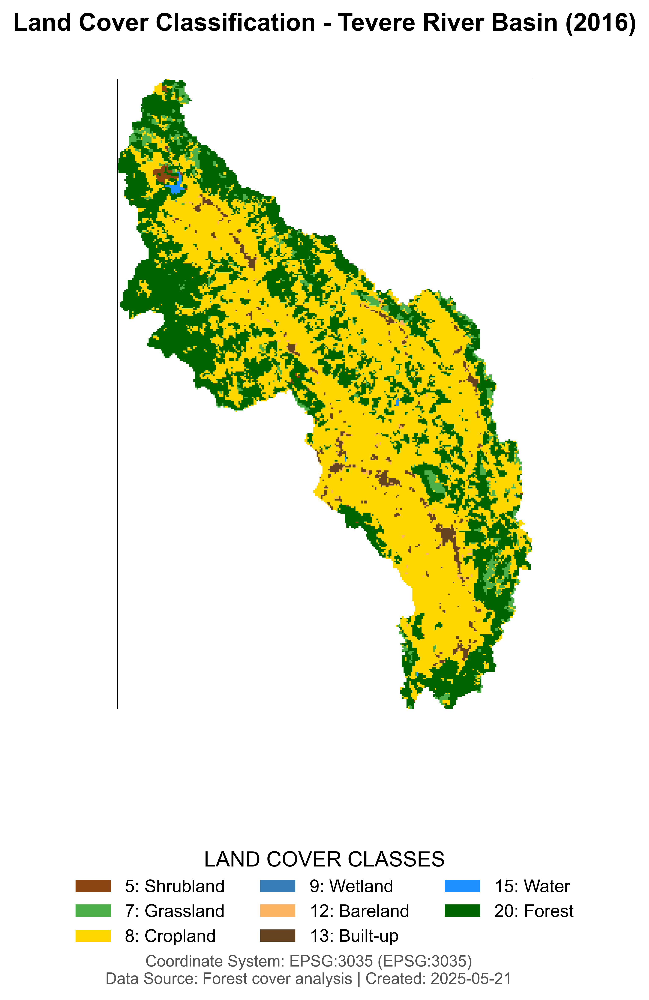

In [41]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import Patch
from matplotlib import rcParams
import datetime

# ======================
# CONFIGURATION
# ======================

# File paths
raster_path = '/Users/ghulamabbaszafari/Downloads/rest/Clip_Tevere_basin/Tevere _2016.tif'
output_path = '/Users/ghulamabbaszafari/Downloads/Tevere_Land_Cover_2016.png'

# Visualization parameters
DPI = 600  # High resolution for publication quality
FIG_SIZE = (10, 8)  # Inches (width, height)
FONT_SIZE = 11
TITLE_FONT_SIZE = 14

# Class definitions
CLASS_LABELS = {
    5: "Shrubland",
    7: "Grassland",
    8: "Cropland",
    9: "Wetland",
    11: "Lichens and Mosses",
    12: "Bareland",
    13: "Built-up",
    15: "Water",
    16: "Permanent ice and Snow",
    20: "Forest",
    255: "NoData"
}

# Color mapping
COLOR_MAP = {
    "Shrubland": '#8B4513',            # SaddleBrown
    "Grassland": '#4DAF4A',            # Green (colorblind-friendly)
    "Cropland": '#FFD700',             # Gold
    "Wetland": '#377EB8',              # Blue (colorblind-friendly)
    "Lichens and Mosses": '#A9CDA9',   # Light green
    "Bareland": '#FDB462',             # Orange
    "Built-up": '#654321',             # Dark Brown
    "Water": '#1E90FF',                # Dodger Blue
    "Permanent ice and Snow": '#B0C4DE',  # Light Steel Blue
    "Forest": '#006400',               # Dark Green
    "NoData": (0, 0, 0, 0)             # Transparent
}

# ======================
# DATA PROCESSING
# ======================

# Load raster data
with rasterio.open(raster_path) as src:
    data = src.read(1, masked=True)
    bounds = src.bounds
    crs = src.crs

# Identify which class labels are actually present
present_classes = sorted([v for v in CLASS_LABELS.keys() if v in np.unique(data)])

# Prepare colormap and normalization
colors = [COLOR_MAP[CLASS_LABELS[v]] for v in present_classes]
cmap = ListedColormap(colors)
boundaries = [c - 0.5 for c in present_classes] + [present_classes[-1] + 0.5]
norm = BoundaryNorm(boundaries, len(present_classes))

# ======================
# VISUALIZATION
# ======================

# Use a valid built-in matplotlib style
plt.style.use('classic')

# Update font and figure settings
rcParams.update({
    'font.family': 'Arial',
    'font.size': FONT_SIZE,
    'axes.titlesize': TITLE_FONT_SIZE,
    'axes.titleweight': 'bold',
    'savefig.dpi': DPI,
    'savefig.bbox': 'tight',
    'savefig.pad_inches': 0.1
})

# Create figure
fig, ax = plt.subplots(figsize=FIG_SIZE, dpi=DPI, facecolor='white')
fig.subplots_adjust(bottom=0.22)

# Plot raster image
im = ax.imshow(data, cmap=cmap, norm=norm,
               extent=[bounds.left, bounds.right, bounds.bottom, bounds.top],
               interpolation='nearest')

# Draw boundary rectangle
boundary = plt.Rectangle((bounds.left, bounds.bottom),
                         bounds.right - bounds.left,
                         bounds.top - bounds.bottom,
                         fill=False, edgecolor='black', linewidth=0.6)
ax.add_patch(boundary)

# Hide axis
ax.set_axis_off()

# Add title
title = ax.set_title("Land Cover Classification - Tevere River Basin (2016)",
                     pad=20, fontsize=TITLE_FONT_SIZE, fontweight='bold')
title.set_position([0.5, 1.02])

# ======================
# LEGEND & ATTRIBUTION
# ======================

# Legend
legend_elements = [
    Patch(facecolor=COLOR_MAP[CLASS_LABELS[v]],
          edgecolor='none',
          label=f"{v}: {CLASS_LABELS[v]}")
    for v in present_classes
]
legend = ax.legend(handles=legend_elements,
                   loc='upper center',
                   bbox_to_anchor=(0.5, -0.20),
                   ncol=3,
                   frameon=False,
                   title='LAND COVER CLASSES',
                   title_fontsize=FONT_SIZE + 1,
                   fontsize=FONT_SIZE - 1)

# Attribution text
attribution_text = (f"Coordinate System: EPSG:{crs.to_epsg()} ({crs.to_string()})\n"
                    f"Data Source: Forest cover analysis | Created: {datetime.date.today().strftime('%Y-%m-%d')}")
plt.figtext(0.5, 0.01, attribution_text,
            ha='center', fontsize=FONT_SIZE - 2, color='#555555')

# Adjust subplot params to avoid clipping legend/attribution
fig.subplots_adjust(bottom=0.28)

# EXPORT & DISPLAY
# ======================
# Create output directory if it doesn't exist
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Save as high-quality PNG
plt.savefig(output_path, dpi=DPI, bbox_inches='tight', facecolor='white',
           metadata={'CreationDate': None, 'Software': 'Python/Matplotlib'})


In [96]:
import os
import grass.script as gs

def check_grass_environment():
    """Verify GRASS environment is properly configured"""
    print("\n=== GRASS ENVIRONMENT CHECK ===")
    
    try:
        # Check basic GRASS functionality
        version = gs.version()
        print(f"GRASS Version: {version['version']}")
        print(f"Build Date: {version['build_date']}")
        
        # Check GISDBASE exists
        gisdbase = gs.gisenv()['GISDBASE']
        if not os.path.exists(gisdbase):
            print(f"ERROR: GISDBASE directory doesn't exist: {gisdbase}")
            return False
        
        # Check location and mapset
        location = gs.gisenv()['LOCATION_NAME']
        mapset = gs.gisenv()['MAPSET']
        location_path = os.path.join(gisdbase, location)
        
        if not os.path.exists(location_path):
            print(f"ERROR: Location directory doesn't exist: {location_path}")
            return False
            
        mapset_path = os.path.join(location_path, mapset)
        if not os.path.exists(mapset_path):
            print(f"ERROR: Mapset directory doesn't exist: {mapset_path}")
            return False
        
        # Check permissions
        if not os.access(mapset_path, os.W_OK):
            print(f"ERROR: No write permissions for mapset: {mapset_path}")
            return False
        
        print("✓ GRASS environment appears valid")
        return True
        
    except Exception as e:
        print(f"GRASS environment check failed: {str(e)}")
        return False

if not check_grass_environment():
    print("\nCRITICAL: GRASS environment is not properly configured.")
    print("Try creating a new location:")
    print("1. grass -c EPSG:3035 ~/grassdata/new_tevere_location")
    print("2. Then restart GRASS with the new location")
    exit()

    


=== GRASS ENVIRONMENT CHECK ===
GRASS Version: 8.4.1
Build Date: 2025-02-25
✓ GRASS environment appears valid


In [80]:
import grass.script.setup as gsetup
print(gsetup.init.__doc__)


Initialize system variables to run GRASS modules

    This function is for running GRASS GIS without starting it with the
    standard main executable grass. No GRASS modules shall be called before
    call of this function but any module or user script can be called
    afterwards because a GRASS session has been set up. GRASS Python
    libraries are usable as well in general but the ones using C
    libraries through ``ctypes`` are not (which is caused by library
    path not being updated for the current process which is a common
    operating system limitation).

    When the path or specified mapset does not exist, ValueError is raised.

    The :func:`get_install_path` function is used to determine where
    the rest of GRASS files is installed. The *grass_path* parameter is
    passed to it if provided. If the path cannot be determined,
    ValueError is raised. Exceptions from the underlying function are propagated.

    To create a GRASS session a session file (aka gisrc file

In [86]:
import grass.script as gs
import grass.script.setup as gsetup

mapset_path = "/Users/ghulamabbaszafari/grassdata/my_location/PERMANENT"
raster_name = "tevere_2019"

with gsetup.init(mapset_path) as session:
    # Print current region
    gs.run_command("g.region", raster=raster_name, flags='p')

    # Set region to match raster extent
    gs.run_command("g.region", raster=raster_name)

    # Print region info again
    gs.run_command("g.region", flags='p')


projection: 99 (ETRS89-extended / LAEA Europe)
zone:       0
datum:      etrs89
ellipsoid:  grs80
north:      2300729.18662628
south:      2174729.18662628
west:       4476049.43902659
east:       4559149.43902659
nsres:      300
ewres:      300
rows:       420
cols:       277
cells:      116340
projection: 99 (ETRS89-extended / LAEA Europe)
zone:       0
datum:      etrs89
ellipsoid:  grs80
north:      2300729.18662628
south:      2174729.18662628
west:       4476049.43902659
east:       4559149.43902659
nsres:      300
ewres:      300
rows:       420
cols:       277
cells:      116340


In [2]:
import os
import grass.script as gs

# Class labels for reclassification
class_labels = {
    5: 'Shrubland',
    7: 'Grassland',
    8: 'Cropland',
    9: 'Wetland',
    11: 'Lichens and mosses',
    12: 'Bareland',
    13: 'Built-up',
    15: 'Water',
    16: 'Permanent ice and Snow',
    20: 'Forest',
    255: 'No data'
}

# Corresponding colors for visualization
color_map = {
    'Shrubland': '#8b4513',
    'Grassland': '#32cd32',
    'Cropland': '#ffd700',
    'Wetland': '#4682b4',
    'Lichens and mosses': '#a9cda9',
    'Bareland': '#c2b280',
    'Built-up': '#808080',
    'Water': '#1e90ff',
    'Permanent ice and Snow': '#b0c4de',
    'Forest': '#006400',
    'No data': '#ffffff'
}

def import_clipped_landcover_data():
    """Import clipped land cover maps and apply labels/colors."""
    directory_path = '/Users/ghulamabbaszafari/Downloads/rest/Clip_Tevere_basin'
    
    # Look for common raster formats
    raster_files = [f for f in os.listdir(directory_path) 
                   if (f.lower().endswith('.tif') or f.lower().endswith('.nc')) 
                   and not f.endswith('.aux.xml')]
    raster_files.sort()

    print(f"Found {len(raster_files)} raster files to import.")

    raster_dict = {}
    failed_imports = []

    for raster_file in raster_files:
        try:
            # Extract year from filename - new pattern for clipped files
            base_name = os.path.splitext(raster_file)[0]
            
            # Handle both "Tevere_YYYY" and "tevere_YYYY" patterns
            if "Tevere_" in base_name or "tevere_" in base_name:
                year_part = base_name.split('_')[-1]
                if year_part.isdigit() and len(year_part) == 4:
                    year = year_part
                else:
                    print(f"Skipping {raster_file} (invalid year format)")
                    continue
            else:
                print(f"Skipping {raster_file} (unexpected filename pattern)")
                continue

            raster_name = f"clipped_land_cover_{year}"
            filepath = os.path.join(directory_path, raster_file)

            print(f"\nImporting {raster_file} as {raster_name}...")

            # Import with projection override
            gs.run_command('r.in.gdal',
                         input=filepath,
                         output=raster_name,
                         band=1,
                         flags='o',
                         overwrite=True)

            # Set nodata values (0, 255) to NULL
            gs.run_command('r.null', map=raster_name, setnull='0,255')

            # Assign category labels (tab-separated)
            label_rules = "\n".join(f"{k}\t{v}" for k, v in class_labels.items())
            gs.write_command('r.category', map=raster_name, rules='-', stdin=label_rules)

            # Assign color rules (space-separated)
            color_rules = "\n".join(
                f"{k} {color_map[v]}" for k, v in class_labels.items() if v in color_map
            )
            gs.write_command('r.colors', map=raster_name, rules='-', stdin=color_rules)

            raster_dict[year] = raster_name
            print(f"✓ Imported and styled: {raster_name}")

        except Exception as e:
            print(f"✗ FAILED: {raster_file} ({str(e)})")
            failed_imports.append(raster_file)

    # Summary
    if failed_imports:
        print("\n❌ Failed imports:")
        for f in failed_imports:
            print(f" - {f}")
    else:
        print("\n✅ All files imported and styled successfully!")

    return raster_dict

# Run it
if __name__ == "__main__":
    import_clipped_landcover_data()


    

Found 31 raster files to import.

Importing Tevere_1992.tif as clipped_land_cover_1992...


Over-riding projection check
Importing raster map <clipped_land_cover_1992>...


Color table for raster map <clipped_land_cover_1992> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_1994>...



✓ Imported and styled: clipped_land_cover_1992

Importing Tevere_1994.tif as clipped_land_cover_1994...



Color table for raster map <clipped_land_cover_1994> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_1995>...


✓ Imported and styled: clipped_land_cover_1994

Importing Tevere_1995.tif as clipped_land_cover_1995...




Color table for raster map <clipped_land_cover_1995> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_1996>...



✓ Imported and styled: clipped_land_cover_1995

Importing Tevere_1996.tif as clipped_land_cover_1996...



Color table for raster map <clipped_land_cover_1996> set to 'rules'


✓ Imported and styled: clipped_land_cover_1996

Importing Tevere_1997.tif as clipped_land_cover_1997...


Over-riding projection check
Importing raster map <clipped_land_cover_1997>...


Color table for raster map <clipped_land_cover_1997> set to 'rules'


✓ Imported and styled: clipped_land_cover_1997

Importing Tevere_1998.tif as clipped_land_cover_1998...


Over-riding projection check
Importing raster map <clipped_land_cover_1998>...


Color table for raster map <clipped_land_cover_1998> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_2000>...


✓ Imported and styled: clipped_land_cover_1998

Importing Tevere_2000.tif as clipped_land_cover_2000...




Color table for raster map <clipped_land_cover_2000> set to 'rules'


✓ Imported and styled: clipped_land_cover_2000

Importing Tevere_2001.tif as clipped_land_cover_2001...


Over-riding projection check
Importing raster map <clipped_land_cover_2001>...


Color table for raster map <clipped_land_cover_2001> set to 'rules'


✓ Imported and styled: clipped_land_cover_2001

Importing Tevere_2002.tif as clipped_land_cover_2002...


Over-riding projection check
Importing raster map <clipped_land_cover_2002>...


Color table for raster map <clipped_land_cover_2002> set to 'rules'


✓ Imported and styled: clipped_land_cover_2002

Importing Tevere_2003.tif as clipped_land_cover_2003...


Over-riding projection check
Importing raster map <clipped_land_cover_2003>...


Color table for raster map <clipped_land_cover_2003> set to 'rules'


✓ Imported and styled: clipped_land_cover_2003

Importing Tevere_2004.tif as clipped_land_cover_2004...


Over-riding projection check
Importing raster map <clipped_land_cover_2004>...


Color table for raster map <clipped_land_cover_2004> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_2005>...


✓ Imported and styled: clipped_land_cover_2004

Importing Tevere_2005.tif as clipped_land_cover_2005...




Color table for raster map <clipped_land_cover_2005> set to 'rules'


✓ Imported and styled: clipped_land_cover_2005

Importing Tevere_2006.tif as clipped_land_cover_2006...


Over-riding projection check
Importing raster map <clipped_land_cover_2006>...


Color table for raster map <clipped_land_cover_2006> set to 'rules'


✓ Imported and styled: clipped_land_cover_2006

Importing Tevere_2007.tif as clipped_land_cover_2007...


Over-riding projection check
Importing raster map <clipped_land_cover_2007>...


Color table for raster map <clipped_land_cover_2007> set to 'rules'


✓ Imported and styled: clipped_land_cover_2007

Importing Tevere_2008.tif as clipped_land_cover_2008...


Over-riding projection check
Importing raster map <clipped_land_cover_2008>...


Color table for raster map <clipped_land_cover_2008> set to 'rules'


✓ Imported and styled: clipped_land_cover_2008

Importing Tevere_2009.tif as clipped_land_cover_2009...


Over-riding projection check
Importing raster map <clipped_land_cover_2009>...


Color table for raster map <clipped_land_cover_2009> set to 'rules'


✓ Imported and styled: clipped_land_cover_2009

Importing Tevere_2010.tif as clipped_land_cover_2010...


Over-riding projection check
Importing raster map <clipped_land_cover_2010>...


Color table for raster map <clipped_land_cover_2010> set to 'rules'


✓ Imported and styled: clipped_land_cover_2010

Importing Tevere_2011.tif as clipped_land_cover_2011...


Over-riding projection check
Importing raster map <clipped_land_cover_2011>...


Color table for raster map <clipped_land_cover_2011> set to 'rules'


✓ Imported and styled: clipped_land_cover_2011

Importing Tevere_2012.tif as clipped_land_cover_2012...


Over-riding projection check
Importing raster map <clipped_land_cover_2012>...


Color table for raster map <clipped_land_cover_2012> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_2013>...


✓ Imported and styled: clipped_land_cover_2012

Importing Tevere_2013.tif as clipped_land_cover_2013...




Color table for raster map <clipped_land_cover_2013> set to 'rules'


✓ Imported and styled: clipped_land_cover_2013

Importing Tevere_2014.tif as clipped_land_cover_2014...


Over-riding projection check
Importing raster map <clipped_land_cover_2014>...


Color table for raster map <clipped_land_cover_2014> set to 'rules'


✓ Imported and styled: clipped_land_cover_2014

Importing Tevere_2015.tif as clipped_land_cover_2015...


Over-riding projection check
Importing raster map <clipped_land_cover_2015>...


Color table for raster map <clipped_land_cover_2015> set to 'rules'


✓ Imported and styled: clipped_land_cover_2015

Importing Tevere_2016.tif as clipped_land_cover_2016...


Over-riding projection check
Importing raster map <clipped_land_cover_2016>...


Color table for raster map <clipped_land_cover_2016> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_2017>...



✓ Imported and styled: clipped_land_cover_2016

Importing Tevere_2017.tif as clipped_land_cover_2017...



Color table for raster map <clipped_land_cover_2017> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_2020>...


✓ Imported and styled: clipped_land_cover_2017

Importing Tevere_2020.tif as clipped_land_cover_2020...




Color table for raster map <clipped_land_cover_2020> set to 'rules'


✓ Imported and styled: clipped_land_cover_2020

Importing Tevere_2021.tif as clipped_land_cover_2021...


Over-riding projection check
Importing raster map <clipped_land_cover_2021>...


Color table for raster map <clipped_land_cover_2021> set to 'rules'


✓ Imported and styled: clipped_land_cover_2021

Importing Tevere_2022.tif as clipped_land_cover_2022...


Over-riding projection check
Importing raster map <clipped_land_cover_2022>...


Color table for raster map <clipped_land_cover_2022> set to 'rules'


✓ Imported and styled: clipped_land_cover_2022

Importing tevere_1993.tif as clipped_land_cover_1993...


Over-riding projection check
Importing raster map <clipped_land_cover_1993>...


Color table for raster map <clipped_land_cover_1993> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_1999>...



✓ Imported and styled: clipped_land_cover_1993

Importing tevere_1999.tif as clipped_land_cover_1999...



Color table for raster map <clipped_land_cover_1999> set to 'rules'
Over-riding projection check
Importing raster map <clipped_land_cover_2018>...


✓ Imported and styled: clipped_land_cover_1999

Importing tevere_2018.tif as clipped_land_cover_2018...




Color table for raster map <clipped_land_cover_2018> set to 'rules'


✓ Imported and styled: clipped_land_cover_2018

Importing tevere_2019.tif as clipped_land_cover_2019...


Over-riding projection check
Importing raster map <clipped_land_cover_2019>...




✓ Imported and styled: clipped_land_cover_2019

✅ All files imported and styled successfully!


Color table for raster map <clipped_land_cover_2019> set to 'rules'


In [4]:
import grass.script as gs
import pandas as pd

# Class labels
class_labels = {
    5: 'Shrubland',
    7: 'Grassland',
    8: 'Cropland',
    9: 'Wetland',
    11: 'Lichens and mosses',
    12: 'Bareland',
    13: 'Built-up',
    15: 'Water',
    16: 'Permanent ice and Snow',
    20: 'Forest',
    255: 'No data'
}

def get_clipped_landcover_maps():
    """List all clipped land cover rasters"""
    maps = gs.read_command('g.list', type='raster', pattern="clipped_land_cover_*", flags='m').splitlines()
    return sorted(maps)

def summarize_clipped_landcover_areas():
    """Summarize area (in km²) for each clipped land cover map"""
    data = []
    maps = get_clipped_landcover_maps()
    
    for raster_name in maps:
        # Get stats with space-separated output
        stats = gs.read_command('r.stats', flags='ac', input=raster_name, separator='space').strip().splitlines()
        year = raster_name.replace("clipped_land_cover_", "").replace("@PERMANENT", "")
        
        if not stats:
            print(f"Warning: No statistics found for {raster_name}")
            continue
            
        class_areas = {'Year': year}
        
        for line in stats:
            try:
                parts = line.split()
                if len(parts) < 3:
                    continue
                    
                cat = parts[0]
                area_m2 = float(parts[1])  # Area in square meters
                area_km2 = area_m2 / 1000000  # Convert to km²
                
                try:
                    cat_int = int(cat)
                    label = class_labels.get(cat_int, f'Class {cat}')
                    class_areas[label] = area_km2
                except ValueError:
                    continue  # Skip non-integer categories
                    
            except Exception as e:
                print(f"Skipping line: {line} (error: {str(e)})")
                continue

        data.append(class_areas)

    df = pd.DataFrame(data)
    df = df.fillna(0)
    
    # Ensure columns are in consistent order
    all_columns = ['Year'] + list(class_labels.values())
    df = df.reindex(columns=[col for col in all_columns if col in df.columns])
    
    return df.sort_values("Year").reset_index(drop=True)

if __name__ == "__main__":
    df_summary = summarize_clipped_landcover_areas()
    print(df_summary.to_string(index=False))


    

Year  Shrubland  Grassland  Cropland  Wetland  Bareland  Built-up  Water  Forest
1992      11.88     129.69   2249.19     0.27     42.12     44.46   7.02 1658.52
1993      11.88     129.69   2248.92     0.27     41.13     45.72   7.02 1658.52
1994      11.88     129.69   2248.74     0.27     39.78     47.25   7.02 1658.52
1995      11.88     130.50   2254.95     0.27     38.79     49.32   7.02 1650.42
1996      11.88     130.68   2257.92     0.27     37.98     51.12   7.02 1646.28
1997      11.88     131.85   2263.59     0.27     37.53     52.47   7.02 1638.54
1998      11.79     133.83   2286.18     0.27     36.72     54.63   7.02 1612.71
1999      11.88     139.05   2325.78     0.27     35.37     57.51   7.02 1566.27
2000      11.88     143.91   2355.84     0.27     34.02     59.58   7.02 1530.63
2001      11.88     145.08   2370.69     0.27     33.57     60.21   7.02 1514.43
2002      11.79     145.98   2370.15     0.27     32.04     62.19   7.02 1513.71
2003      11.79     145.89  

In [5]:
import grass.script as gs
import pandas as pd
from tabulate import tabulate

# Class labels
class_labels = {
    5: 'Shrubland',
    7: 'Grassland',
    8: 'Cropland',
    9: 'Wetland',
    11: 'Lichens and mosses',
    12: 'Bareland',
    13: 'Built-up',
    15: 'Water',
    16: 'Permanent ice and Snow',
    20: 'Forest',
    255: 'No data'
}

def format_number(num):
    """Format numbers with commas and 2 decimal places"""
    return f"{num:,.2f}"

def format_percentage(num, total):
    """Format percentage with 2 decimal places"""
    return f"{(num/total)*100:.2f}%"

def generate_yearly_stats(raster_name):
    """Generate formatted statistics for a single year"""
    stats = gs.read_command('r.stats', flags='acn', input=raster_name, separator='space').strip().splitlines()
    
    if not stats:
        print(f"Warning: No statistics found for {raster_name}")
        return None
    
    # Process statistics
    results = []
    total_area = 0
    year = raster_name.replace("clipped_land_cover_", "").replace("@PERMANENT", "")
    
    for line in stats:
        parts = line.split()
        if len(parts) < 3:
            continue
            
        cat = parts[0]
        count = int(float(parts[1]))  # Cell count
        area_m2 = float(parts[2])     # Area in square meters
        area_km2 = area_m2 / 1000000  # Convert to km²
        
        try:
            cat_int = int(cat)
            label = class_labels.get(cat_int, f'Class {cat}')
            results.append({
                'class': cat_int,
                'label': label,
                'count': count,
                'area_km2': area_km2
            })
            total_area += area_km2
        except ValueError:
            continue
    
    # Calculate percentages and format output
    formatted_results = []
    for item in sorted(results, key=lambda x: x['area_km2'], reverse=True):
        formatted_results.append([
            item['class'],
            item['label'],
            f"{item['count']:,}",
            format_number(item['area_km2']),
            format_percentage(item['area_km2'], total_area)
        ])
    
    # Print formatted table
    print(f"\nSample Statistics for {year}:")
    print(tabulate(formatted_results, 
                  headers=['class', 'label', 'count', 'area_km2', 'pct'],
                  tablefmt='simple'))
    
    return results, total_area

def generate_all_stats():
    """Generate statistics for all years and save to CSV"""
    maps = gs.read_command('g.list', type='raster', 
                          pattern="clipped_land_cover_*", 
                          flags='m').splitlines()
    maps = sorted(maps)
    
    all_data = []
    yearly_totals = []
    
    for raster_name in maps:
        year = raster_name.replace("clipped_land_cover_", "").replace("@PERMANENT", "")
        stats, total_area = generate_yearly_stats(raster_name)
        
        if not stats:
            continue
            
        # Add to yearly totals
        yearly_totals.append({
            'Year': year,
            'Total Area (km2)': format_number(total_area)
        })
        
        # Add to all data
        for item in stats:
            all_data.append({
                'Year': year,
                'Class': item['class'],
                'Label': item['label'],
                'Count': item['count'],
                'Area_km2': item['area_km2'],
                'Percentage': (item['area_km2']/total_area)*100
            })
    
    # Create DataFrames
    df_all = pd.DataFrame(all_data)
    df_totals = pd.DataFrame(yearly_totals)
    
    # Save to CSV
    df_all.to_csv('land_cover_stats_detailed.csv', index=False)
    df_totals.to_csv('land_cover_totals_by_year.csv', index=False)
    
    print("\nSaved detailed statistics to 'land_cover_stats_detailed.csv'")
    print("Saved yearly totals to 'land_cover_totals_by_year.csv'")
    
    return df_all, df_totals

if __name__ == "__main__":
    detailed_df, totals_df = generate_all_stats()
    
    # Print summary table (similar to your previous output)
    summary_df = detailed_df.pivot_table(
        index='Year',
        columns='Label',
        values='Area_km2',
        aggfunc='sum'
    ).fillna(0)
    
    # Reorder columns to match your desired output
    column_order = ['Shrubland', 'Grassland', 'Cropland', 'Wetland', 
                   'Bareland', 'Built-up', 'Water', 'Forest']
    summary_df = summary_df[column_order]
    
    print("\nSummary Table:")
    print(summary_df.to_string(float_format="%.2f"))
    
    # Save summary table
    summary_df.to_csv('land_cover_summary.csv')
    print("\nSaved summary table to 'land_cover_summary.csv'")

    


Sample Statistics for 1992:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,249,190,000        0.02  54.29%
     20  Forest     1,658,520,000        0.02  40.03%
      7  Grassland  129,690,000          0     3.13%
     13  Built-up   44,460,000           0     1.07%
     12  Bareland   42,120,000           0     1.02%
      5  Shrubland  11,880,000           0     0.29%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 1993:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,248,920,000        0.02  54.28%
     20  Forest     1,658,520,000        0.02  40.03%
      7  Grassland  129,690,000          0     3.13%
     13  Built-up   45,720,000           0     1.10%
     12  Bareland   41,130,000           0     0.99%
      5  Shrubland  11,880,000         


Sample Statistics for 1994:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,248,740,000        0.02  54.28%
     20  Forest     1,658,520,000        0.02  40.03%
      7  Grassland  129,690,000          0     3.13%
     13  Built-up   47,250,000           0     1.14%
     12  Bareland   39,780,000           0     0.96%
      5  Shrubland  11,880,000           0     0.29%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 1995:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,254,950,000        0.03  54.43%
     20  Forest     1,650,420,000        0.02  39.83%
      7  Grassland  130,500,000          0     3.15%
     13  Built-up   49,320,000           0     1.19%
     12  Bareland   38,790,000           0     0.94%
      5  Shrubland  11,880,000         


Sample Statistics for 1996:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,257,920,000        0.03  54.50%
     20  Forest     1,646,280,000        0.02  39.73%
      7  Grassland  130,680,000          0     3.15%
     13  Built-up   51,120,000           0     1.23%
     12  Bareland   37,980,000           0     0.92%
      5  Shrubland  11,880,000           0     0.29%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 1997:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,263,590,000        0.03  54.63%
     20  Forest     1,638,540,000        0.02  39.55%
      7  Grassland  131,850,000          0     3.18%
     13  Built-up   52,470,000           0     1.27%
     12  Bareland   37,530,000           0     0.91%
      5  Shrubland  11,880,000         


Sample Statistics for 1998:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,286,180,000        0.03  55.18%
     20  Forest     1,612,710,000        0.02  38.92%
      7  Grassland  133,830,000          0     3.23%
     13  Built-up   54,630,000           0     1.32%
     12  Bareland   36,720,000           0     0.89%
      5  Shrubland  11,790,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 1999:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,325,780,000        0.03  56.14%
     20  Forest     1,566,270,000        0.02  37.80%
      7  Grassland  139,050,000          0     3.36%
     13  Built-up   57,510,000           0     1.39%
     12  Bareland   35,370,000           0     0.85%
      5  Shrubland  11,880,000         


Sample Statistics for 2000:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,355,840,000        0.03  56.86%
     20  Forest     1,530,630,000        0.02  36.94%
      7  Grassland  143,910,000          0     3.47%
     13  Built-up   59,580,000           0     1.44%
     12  Bareland   34,020,000           0     0.82%
      5  Shrubland  11,880,000           0     0.29%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2001:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,370,690,000        0.03  57.22%
     20  Forest     1,514,430,000        0.02  36.55%
      7  Grassland  145,080,000          0     3.50%
     13  Built-up   60,210,000           0     1.45%
     12  Bareland   33,570,000           0     0.81%
      5  Shrubland  11,880,000         


Sample Statistics for 2002:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,370,150,000        0.03  57.21%
     20  Forest     1,513,710,000        0.02  36.54%
      7  Grassland  145,980,000          0     3.52%
     13  Built-up   62,190,000           0     1.50%
     12  Bareland   32,040,000           0     0.77%
      5  Shrubland  11,790,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2003:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,364,930,000        0.03  57.08%
     20  Forest     1,518,120,000        0.02  36.64%
      7  Grassland  145,890,000          0     3.52%
     13  Built-up   64,440,000           0     1.56%
     12  Bareland   30,690,000           0     0.74%
      5  Shrubland  11,790,000         


Sample Statistics for 2004:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,368,890,000        0.03  57.18%
     20  Forest     1,511,820,000        0.02  36.49%
      7  Grassland  147,330,000          0     3.56%
     13  Built-up   66,780,000           0     1.61%
     12  Bareland   29,430,000           0     0.71%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2005:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,361,150,000        0.03  56.99%
     20  Forest     1,518,030,000        0.02  36.64%
      7  Grassland  147,060,000          0     3.55%
     13  Built-up   69,930,000           0     1.69%
     12  Bareland   28,080,000           0     0.68%
      5  Shrubland  11,610,000         


Sample Statistics for 2006:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,359,350,000        0.03  56.95%
     20  Forest     1,518,030,000        0.02  36.64%
      7  Grassland  147,060,000          0     3.55%
     13  Built-up   72,630,000           0     1.75%
     12  Bareland   27,180,000           0     0.66%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2007:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,349,810,000        0.03  56.72%
     20  Forest     1,522,710,000        0.02  36.75%
      7  Grassland  146,970,000          0     3.55%
     13  Built-up   81,180,000           0     1.96%
     12  Bareland   23,580,000           0     0.57%
      5  Shrubland  11,610,000         


Sample Statistics for 2008:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,343,510,000        0.03  56.56%
     20  Forest     1,526,670,000        0.02  36.85%
      7  Grassland  146,700,000          0     3.54%
     13  Built-up   85,230,000           0     2.06%
     12  Bareland   22,140,000           0     0.53%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2009:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,335,320,000        0.03  56.37%
     20  Forest     1,533,510,000        0.02  37.01%
      7  Grassland  145,890,000          0     3.52%
     13  Built-up   88,200,000           0     2.13%
     12  Bareland   21,330,000           0     0.51%
      5  Shrubland  11,610,000         


Sample Statistics for 2010:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,337,120,000        0.03  56.41%
     20  Forest     1,530,090,000        0.02  36.93%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   90,090,000           0     2.17%
     12  Bareland   20,790,000           0     0.50%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2011:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,335,770,000        0.03  56.38%
     20  Forest     1,530,270,000        0.02  36.93%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   92,070,000           0     2.22%
     12  Bareland   19,980,000           0     0.48%
      5  Shrubland  11,610,000         


Sample Statistics for 2012:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,337,300,000        0.03  56.41%
     20  Forest     1,527,300,000        0.02  36.86%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   93,780,000           0     2.26%
     12  Bareland   19,710,000           0     0.48%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2013:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,334,330,000        0.03  56.34%
     20  Forest     1,528,110,000        0.02  36.88%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   96,480,000           0     2.33%
     12  Bareland   19,170,000           0     0.46%
      5  Shrubland  11,610,000         


Sample Statistics for 2014:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,325,780,000        0.03  56.14%
     20  Forest     1,534,320,000        0.02  37.03%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   99,270,000           0     2.40%
     12  Bareland   18,720,000           0     0.45%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2015:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,323,620,000        0.03  56.08%
     20  Forest     1,534,320,000        0.02  37.03%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   101,970,000          0     2.46%
     12  Bareland   18,180,000           0     0.44%
      5  Shrubland  11,610,000         


Sample Statistics for 2016:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,322,540,000        0.03  56.06%
     20  Forest     1,535,400,000        0.02  37.06%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   101,970,000          0     2.46%
     12  Bareland   18,180,000           0     0.44%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2017:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,321,640,000        0.03  56.04%
     20  Forest     1,536,030,000        0.02  37.07%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   102,420,000          0     2.47%
     12  Bareland   18,000,000           0     0.43%
      5  Shrubland  11,610,000         


Sample Statistics for 2018:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,320,470,000        0.03  56.01%
     20  Forest     1,537,110,000        0.02  37.10%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   102,510,000          0     2.47%
     12  Bareland   18,000,000           0     0.43%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2019:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,318,130,000        0.03  55.95%
     20  Forest     1,539,450,000        0.02  37.16%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   102,510,000          0     2.47%
     12  Bareland   18,000,000           0     0.43%
      5  Shrubland  11,610,000         


Sample Statistics for 2020:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,318,130,000        0.03  55.95%
     20  Forest     1,539,450,000        0.02  37.16%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   102,510,000          0     2.47%
     12  Bareland   18,000,000           0     0.43%
      5  Shrubland  11,610,000           0     0.28%
     15  Water      7,020,000            0     0.17%
      9  Wetland    270,000              0     0.01%

Sample Statistics for 2021:
  class  label      count            area_km2  pct
-------  ---------  -------------  ----------  ------
      8  Cropland   2,317,950,000        0.03  55.95%
     20  Forest     1,539,090,000        0.02  37.15%
      7  Grassland  146,160,000          0     3.53%
     13  Built-up   103,500,000          0     2.50%
     12  Bareland   17,550,000           0     0.42%
      5  Shrubland  11,610,000         

In [10]:
import os
import grass.script as gs
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import Patch
from matplotlib import rcParams
import datetime
import tempfile
import rasterio

# ======================
# CONFIGURATION (using your settings)
# ======================

# Visualization parameters (from your config)
DPI = 600
FIG_SIZE = (10, 8)
FONT_SIZE = 11
TITLE_FONT_SIZE = 14

# Class definitions (from your config)
CLASS_LABELS = {
    5: "Shrubland",
    7: "Grassland",
    8: "Cropland",
    9: "Wetland",
    11: "Lichens and Mosses",
    12: "Bareland",
    13: "Built-up",
    15: "Water",
    16: "Permanent ice and Snow",
    20: "Forest",
    255: "NoData"
}

# Color mapping (from your config)
COLOR_MAP = {
    "Shrubland": '#8B4513',
    "Grassland": '#4DAF4A',
    "Cropland": '#FFD700',
    "Wetland": '#377EB8',
    "Lichens and Mosses": '#A9CDA9',
    "Bareland": '#FDB462',
    "Built-up": '#654321',
    "Water": '#1E90FF',
    "Permanent ice and Snow": '#B0C4DE',
    "Forest": '#006400',
    "NoData": (0, 0, 0, 0)
}

# ======================
# GRASS GIS DATA EXPORT
# ======================

def export_grass_raster(map_name):
    """Export GRASS raster to temporary GeoTIFF with proper settings"""
    temp_dir = tempfile.mkdtemp()
    temp_file = os.path.join(temp_dir, f"{map_name}.tif")
    
    # Export with exact class preservation
    gs.run_command('r.out.gdal',
                  input=map_name,
                  output=temp_file,
                  format='GTiff',
                  type='Byte',
                  createopt='COMPRESS=LZW',
                  nodata=255,
                  overwrite=True)
    return temp_file

# ======================
# VISUALIZATION FUNCTION
# ======================

def visualize_landcover(map_name, output_path):
    """Create publication-quality land cover visualization"""
    # Export from GRASS
    temp_file = export_grass_raster(map_name)
    
    # Load with rasterio (using your exact method)
    with rasterio.open(temp_file) as src:
        data = src.read(1, masked=True)
        bounds = src.bounds
        crs = src.crs
    
    # Clean up temp file
    try:
        os.remove(temp_file)
        os.rmdir(os.path.dirname(temp_file))
    except:
        pass
    
    # Identify present classes
    present_classes = sorted([v for v in CLASS_LABELS.keys() if v in np.unique(data.filled())])
    
    # Prepare colormap and normalization (from your config)
    colors = [COLOR_MAP[CLASS_LABELS[v]] for v in present_classes]
    cmap = ListedColormap(colors)
    boundaries = [c - 0.5 for c in present_classes] + [present_classes[-1] + 0.5]
    norm = BoundaryNorm(boundaries, len(present_classes))
    
    # Apply your exact styling
    plt.style.use('classic')
    rcParams.update({
        'font.family': 'Arial',
        'font.size': FONT_SIZE,
        'axes.titlesize': TITLE_FONT_SIZE,
        'axes.titleweight': 'bold',
        'savefig.dpi': DPI,
        'savefig.bbox': 'tight',
        'savefig.pad_inches': 0.1
    })
    
    # Create figure (from your config)
    fig, ax = plt.subplots(figsize=FIG_SIZE, dpi=DPI, facecolor='white')
    fig.subplots_adjust(bottom=0.22)
    
    # Plot raster image (from your config)
    im = ax.imshow(data, cmap=cmap, norm=norm,
                   extent=[bounds.left, bounds.right, bounds.bottom, bounds.top],
                   interpolation='nearest')
    
    # Draw boundary rectangle (from your config)
    boundary = plt.Rectangle((bounds.left, bounds.bottom),
                             bounds.right - bounds.left,
                             bounds.top - bounds.bottom,
                             fill=False, edgecolor='black', linewidth=0.6)
    ax.add_patch(boundary)
    ax.set_axis_off()
    
    # Add title (adapted for GRASS)
    year = map_name.split('_')[-1]
    title = ax.set_title(f"Land Cover Classification - Tevere River Basin ({year})",
                         pad=20, fontsize=TITLE_FONT_SIZE, fontweight='bold')
    title.set_position([0.5, 1.02])
    
    # Legend (from your config)
    legend_elements = [
        Patch(facecolor=COLOR_MAP[CLASS_LABELS[v]],
              edgecolor='none',
              label=f"{v}: {CLASS_LABELS[v]}")
        for v in present_classes
    ]
    legend = ax.legend(handles=legend_elements,
                       loc='upper center',
                       bbox_to_anchor=(0.5, -0.20),
                       ncol=3,
                       frameon=False,
                       title='LAND COVER CLASSES',
                       title_fontsize=FONT_SIZE + 1,
                       fontsize=FONT_SIZE - 1)
    
    # Attribution text (from your config)
    attribution_text = (f"Coordinate System: EPSG:{crs.to_epsg()} ({crs.to_string()})\n"
                        f"Data Source: ESA CCI Land Cover | Created: {datetime.date.today().strftime('%Y-%m-%d')}")
    plt.figtext(0.5, 0.01, attribution_text,
                ha='center', fontsize=FONT_SIZE - 2, color='#555555')
    
    # Adjust layout (from your config)
    fig.subplots_adjust(bottom=0.28)
    
    # Create output directory if needed (from your config)
    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    
    # Save figure (from your config)
    plt.savefig(output_path, dpi=DPI, bbox_inches='tight', facecolor='white',
               metadata={'CreationDate': None, 'Software': 'Python/Matplotlib'})
    plt.close()
    
    print(f"Visualization saved to {output_path}")

# ======================
# MAIN EXECUTION
# ======================

# Get all available maps in GRASS
maps = gs.read_command('g.list', type='raster', pattern="clipped_land_cover_*").splitlines()
maps = sorted(maps)

# Example usage for one map
if maps:
    sample_map = maps[0]  # First available map
    year = sample_map.split('_')[-1]
    output_path = f'/Users/ghulamabbaszafari/Downloads/Tevere_Land_Cover_{year}.png'
    visualize_landcover(sample_map, output_path)

# Process all maps (uncomment to run)
# for map_name in maps:
#     year = map_name.split('_')[-1]
#     output_path = f'/Users/ghulamabbaszafari/Downloads/Tevere_Land_Cover_{year}.png'
#     visualize_landcover(map_name, output_path)




Checking GDAL data type and nodata value...

Using GDAL data type <Byte>
Exporting raster data to GTiff format...

r.out.gdal complete. File
</var/folders/mz/wk_rk1fs2m96vphdr62m5bym0000gn/T/grass8-ghulamabbaszafari-14257/tmp48dbeveu/clipped_land_cover_1992.tif>
created.


Visualization saved to /Users/ghulamabbaszafari/Downloads/Tevere_Land_Cover_1992.png


Checking GDAL data type and nodata value...

Using GDAL data type <Byte>
Exporting raster data to GTiff format...

r.out.gdal complete. File
</var/folders/mz/wk_rk1fs2m96vphdr62m5bym0000gn/T/grass8-ghulamabbaszafari-14257/tmp3tbfe3v9/clipped_land_cover_1992.tif>
created.
Checking GDAL data type and nodata value...

Using GDAL data type <Byte>
Exporting raster data to GTiff format...

r.out.gdal complete. File
</var/folders/mz/wk_rk1fs2m96vphdr62m5bym0000gn/T/grass8-ghulamabbaszafari-14257/tmphlycfl0i/clipped_land_cover_1992.tif>
created.
Checking GDAL data type and nodata value...

Using GDAL data type <Byte>
Exporting raster data to GTiff format...

r.out.gdal complete. File
</var/folders/mz/wk_rk1fs2m96vphdr62m5bym0000gn/T/grass8-ghulamabbaszafari-14257/tmpge592u7f/clipped_land_cover_1997.tif>
created.
Checking GDAL data type and nodata value...

Using GDAL data type <Byte>
Exporting raster data to GTiff format...

r.out.gdal complete. File
</var/folders/mz/wk_rk1fs2m96vphdr62m5bym00

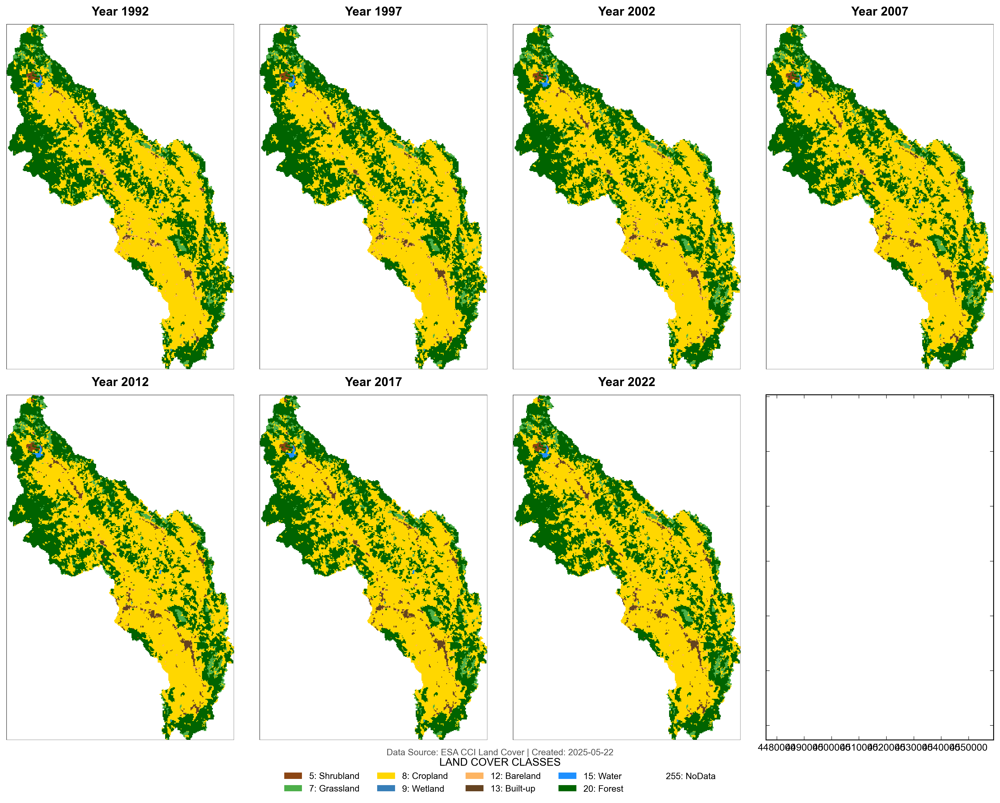

In [11]:
import os
import grass.script as gs
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import Patch
from matplotlib import rcParams
import datetime
import tempfile
import rasterio
from mpl_toolkits.axes_grid1 import ImageGrid

# ======================
# CONFIGURATION (using your settings)
# ======================

# Visualization parameters (from your config)
DPI = 300  # Reduced for better Jupyter display
FIG_SIZE = (18, 12)  # Larger for side-by-side
FONT_SIZE = 11
TITLE_FONT_SIZE = 14

# Class definitions (from your config)
CLASS_LABELS = {
    5: "Shrubland",
    7: "Grassland",
    8: "Cropland",
    9: "Wetland",
    11: "Lichens and Mosses",
    12: "Bareland",
    13: "Built-up",
    15: "Water",
    16: "Permanent ice and Snow",
    20: "Forest",
    255: "NoData"
}

# Color mapping (from your config)
COLOR_MAP = {
    "Shrubland": '#8B4513',
    "Grassland": '#4DAF4A',
    "Cropland": '#FFD700',
    "Wetland": '#377EB8',
    "Lichens and Mosses": '#A9CDA9',
    "Bareland": '#FDB462',
    "Built-up": '#654321',
    "Water": '#1E90FF',
    "Permanent ice and Snow": '#B0C4DE',
    "Forest": '#006400',
    "NoData": (0, 0, 0, 0)
}

# ======================
# DATA PROCESSING FUNCTIONS
# ======================

def export_grass_raster(map_name):
    """Export GRASS raster to temporary GeoTIFF with proper settings"""
    temp_dir = tempfile.mkdtemp()
    temp_file = os.path.join(temp_dir, f"{map_name}.tif")
    
    gs.run_command('r.out.gdal',
                  input=map_name,
                  output=temp_file,
                  format='GTiff',
                  type='Byte',
                  createopt='COMPRESS=LZW',
                  nodata=255,
                  overwrite=True)
    return temp_file

def load_raster_data(map_name):
    """Load and process raster data from GRASS"""
    temp_file = export_grass_raster(map_name)
    
    with rasterio.open(temp_file) as src:
        data = src.read(1, masked=True)
        bounds = src.bounds
        crs = src.crs
    
    # Clean up
    try:
        os.remove(temp_file)
        os.rmdir(os.path.dirname(temp_file))
    except:
        pass
    
    return data, bounds, crs

# ======================
# VISUALIZATION FUNCTIONS
# ======================

def setup_plot_style():
    """Apply your preferred styling"""
    plt.style.use('classic')
    rcParams.update({
        'font.family': 'Arial',
        'font.size': FONT_SIZE,
        'axes.titlesize': TITLE_FONT_SIZE,
        'axes.titleweight': 'bold',
        'figure.dpi': DPI,
        'savefig.bbox': 'tight',
        'savefig.pad_inches': 0.1
    })

def create_side_by_side_plot(maps, ncols=4):
    """Create side-by-side comparison plot"""
    setup_plot_style()
    
    nrows = int(np.ceil(len(maps) / ncols))
    fig = plt.figure(figsize=FIG_SIZE, facecolor='white')
    grid = ImageGrid(fig, 111,
                    nrows_ncols=(nrows, ncols),
                    axes_pad=0.4,
                    share_all=True,
                    cbar_location="right",
                    cbar_mode=None)
    
    # Get colormap and norm from first map
    first_data, _, _ = load_raster_data(maps[0])
    present_classes = sorted([v for v in CLASS_LABELS.keys() if v in np.unique(first_data.filled())])
    colors = [COLOR_MAP[CLASS_LABELS[v]] for v in present_classes]
    cmap = ListedColormap(colors)
    boundaries = [c - 0.5 for c in present_classes] + [present_classes[-1] + 0.5]
    norm = BoundaryNorm(boundaries, len(present_classes))
    
    # Plot each map
    for ax, map_name in zip(grid, maps):
        year = map_name.split('_')[-1]
        data, bounds, _ = load_raster_data(map_name)
        
        im = ax.imshow(data, cmap=cmap, norm=norm,
                      extent=[bounds.left, bounds.right, bounds.bottom, bounds.top],
                      interpolation='nearest')
        
        # Add boundary
        boundary = plt.Rectangle((bounds.left, bounds.bottom),
                                bounds.right - bounds.left,
                                bounds.top - bounds.bottom,
                                fill=False, edgecolor='black', linewidth=0.6)
        ax.add_patch(boundary)
        
        ax.set_title(f"Year {year}", pad=10, fontsize=TITLE_FONT_SIZE)
        ax.set_axis_off()
    
    # Add unified legend
    legend_elements = [
        Patch(facecolor=COLOR_MAP[CLASS_LABELS[v]],
              edgecolor='none',
              label=f"{v}: {CLASS_LABELS[v]}")
        for v in present_classes
    ]
    
    fig.legend(handles=legend_elements,
              loc='lower center',
              bbox_to_anchor=(0.5, -0.05),
              ncol=5,
              frameon=False,
              title='LAND COVER CLASSES',
              title_fontsize=FONT_SIZE + 1,
              fontsize=FONT_SIZE - 1)
    
    # Add attribution
    attribution_text = (f"Data Source: ESA CCI Land Cover | "
                       f"Created: {datetime.date.today().strftime('%Y-%m-%d')}")
    fig.text(0.5, 0.01, attribution_text,
            ha='center', fontsize=FONT_SIZE - 1, color='#555555')
    
    plt.tight_layout()
    plt.show()

# ======================
# MAIN EXECUTION
# ======================

# Get all available maps in GRASS
all_maps = gs.read_command('g.list', type='raster', pattern="clipped_land_cover_*").splitlines()
all_maps = sorted(all_maps)

# Select years to display (modify as needed)
selected_years = ['1992', '1997', '2002', '2007', '2012', '2017', '2022']
selected_maps = [f"clipped_land_cover_{year}" for year in selected_years if f"clipped_land_cover_{year}" in all_maps]

# Create the side-by-side plot
if selected_maps:
    create_side_by_side_plot(selected_maps, ncols=4)
else:
    print("No matching maps found!")

    

Available matplotlib styles: ['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'petroff10', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


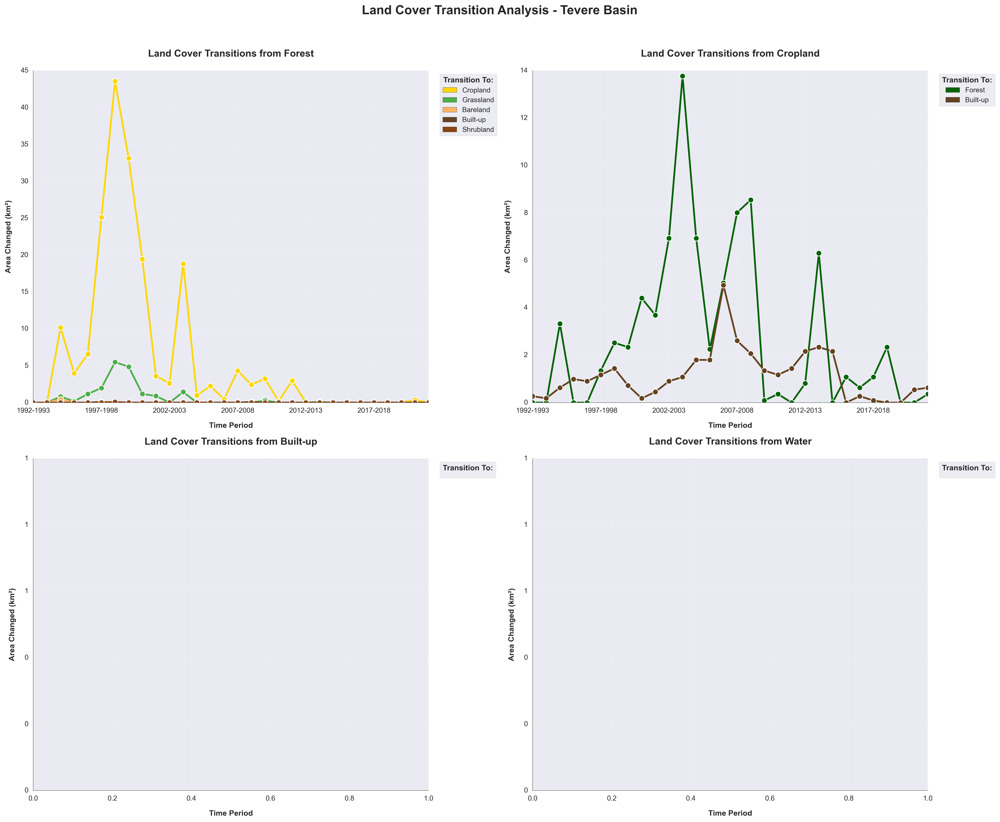

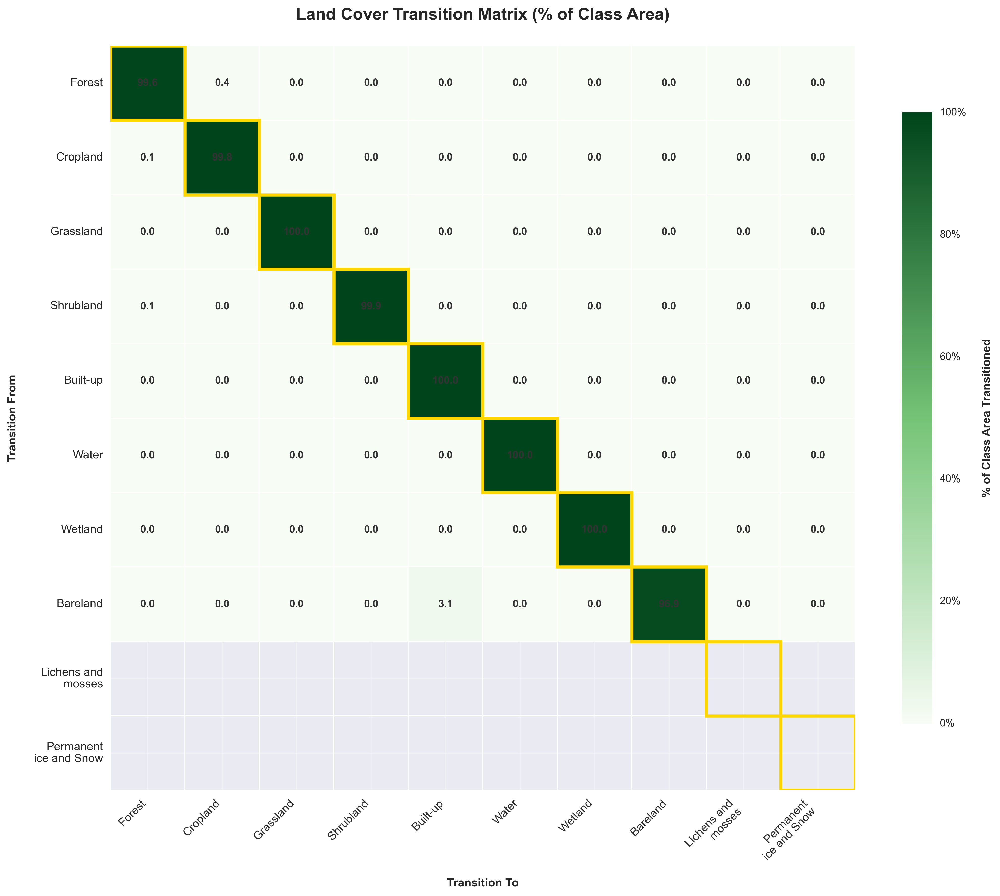

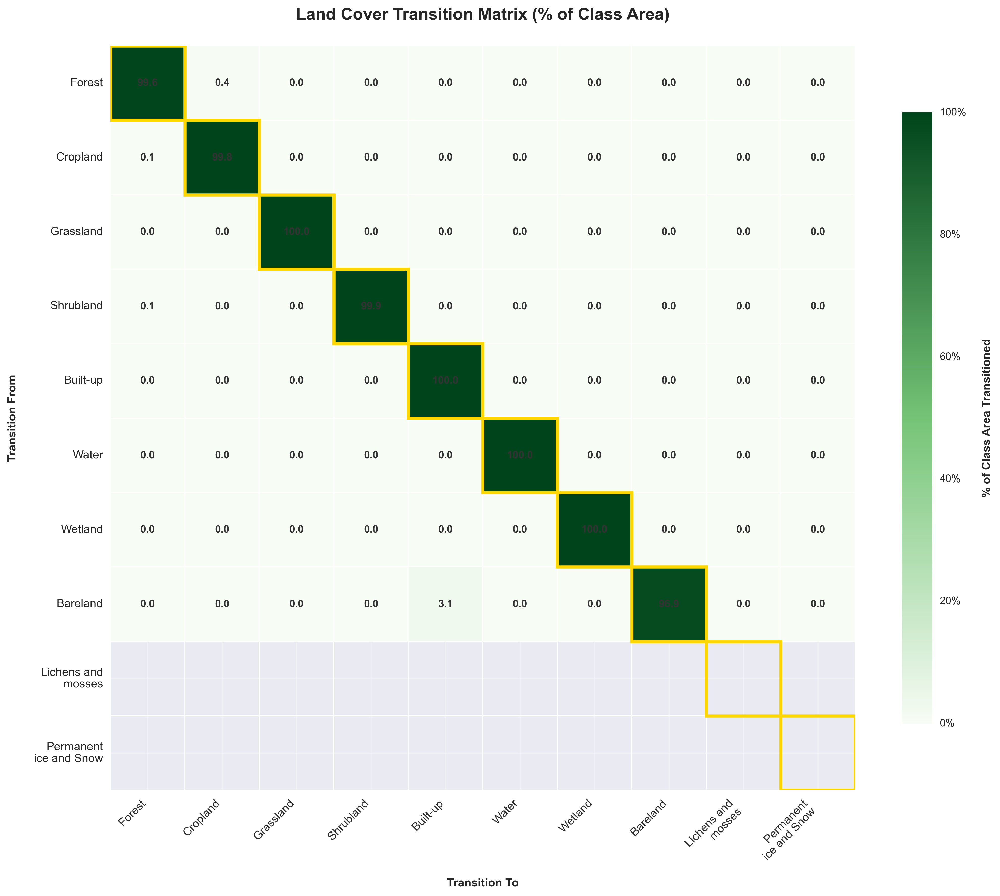


Professional visualizations created and saved:
- /Users/ghulamabbaszafari/Downloads/tevere_transition_plots_pro.png
- /Users/ghulamabbaszafari/Downloads/tevere_transition_matrix_pro.png


In [16]:
import grass.script as gs
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.ticker import FuncFormatter, StrMethodFormatter
from matplotlib.patches import Patch
from textwrap import wrap

# ======================
# STYLING CONFIGURATION
# ======================

# Check available styles and use the most appropriate one
available_styles = plt.style.available
print("Available matplotlib styles:", available_styles)

# Use a style that's available
if 'seaborn' in available_styles:
    plt.style.use('seaborn')
elif 'seaborn-v0_8' in available_styles:
    plt.style.use('seaborn-v0_8')
else:
    plt.style.use('ggplot')  # Fallback style

# Customize the style further
plt.rcParams.update({
    'font.family': 'Arial',
    'font.size': 11,
    'axes.titlesize': 14,
    'axes.titleweight': 'bold',
    'axes.labelweight': 'bold',
    'axes.grid': True,
    'grid.alpha': 0.3,
    'legend.title_fontsize': 11,
    'legend.fontsize': 10,
    'figure.dpi': 300,
    'figure.autolayout': True,
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'axes.edgecolor': '0.3',
    'axes.linewidth': 0.5,
    'xtick.bottom': True,
    'ytick.left': True
})

# Color map for classes (consistent with ESA CCI)
class_colors = {
    'Forest': '#006400',
    'Cropland': '#FFD700',  # Yellow
    'Grassland': '#4DAF4A',
    'Shrubland': '#8B4513',
    'Built-up': '#654321',
    'Water': '#1E90FF',
    'Wetland': '#377EB8',
    'Bareland': '#FDB462',
    'Lichens and mosses': '#A9CDA9',
    'Permanent ice and Snow': '#B0C4DE'
}

# ======================
# TRANSITION PLOT FUNCTION
# ======================

def plot_class_transitions_pro(transitions_df, class_name, ax=None):
    """Professional transition plot for a specific class"""
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 6))
    
    # Filter transitions for this class
    class_trans = transitions_df[transitions_df['From_label'] == class_name]
    
    if class_trans.empty:
        ax.text(0.5, 0.5, f"No transitions from {class_name}", 
                ha='center', va='center', transform=ax.transAxes,
                fontsize=12, color='gray')
        ax.set_axis_off()
        return ax
    
    # Pivot for area by period and destination
    pivot = class_trans.pivot_table(
        index='Period', 
        columns='To_label', 
        values='Area_km2', 
        aggfunc='sum'
    ).fillna(0)
    
    # Get top 5 destinations (excluding self-transitions)
    top_dest = pivot.loc[:, pivot.columns != class_name].sum().nlargest(5).index
    
    # Plot each transition with consistent styling
    for dest in top_dest:
        color = class_colors.get(dest, '#333333')
        pivot[dest].plot(
            ax=ax,
            marker='o',
            markersize=8,
            linewidth=2.5,
            color=color,
            label=dest,
            markeredgecolor='white',
            markeredgewidth=1
        )
    
    # Formatting
    ax.set_title(f"Land Cover Transitions from {class_name}", pad=20, fontweight='bold')
    ax.set_xlabel("Time Period", labelpad=12, fontweight='bold')
    ax.set_ylabel("Area Changed (km²)", labelpad=12, fontweight='bold')
    
    # Format y-axis
    ax.yaxis.set_major_formatter(FuncFormatter(lambda x, _: f"{x:,.0f}"))
    ax.grid(True, alpha=0.2)
    
    # Legend with color blocks
    handles = [Patch(facecolor=class_colors.get(dest, '#333333'), 
                    edgecolor='0.2', label=dest) 
              for dest in top_dest]
    
    legend = ax.legend(
        handles=handles,
        title='Transition To:',
        loc='upper left',
        bbox_to_anchor=(1.02, 1),
        frameon=True,
        framealpha=0.9,
        edgecolor='0.8'
    )
    legend.get_title().set_fontweight('bold')
    
    # Remove top/right spines
    for spine in ['top', 'right']:
        ax.spines[spine].set_visible(False)
    
    return ax

# ======================
# TRANSITION MATRIX FUNCTION WITH YELLOW DIAGONAL
# ======================

def create_transition_matrix_pro(transitions_df):
    """Create professional transition matrix heatmap with yellow diagonal"""
    # Create pivot table
    pivot = transitions_df.pivot_table(
        index='From_label',
        columns='To_label',
        values='Area_km2',
        aggfunc='sum',
        fill_value=0
    )
    
    # Order classes by importance
    class_order = [
        'Forest', 'Cropland', 'Grassland', 'Shrubland',
        'Built-up', 'Water', 'Wetland', 'Bareland',
        'Lichens and mosses', 'Permanent ice and Snow'
    ]
    pivot = pivot.reindex(index=class_order, columns=class_order, fill_value=0)
    
    # Convert to percentages of row totals
    row_totals = pivot.sum(axis=1)
    percentage_matrix = pivot.div(row_totals, axis=0) * 100
    
    # Create figure
    fig, ax = plt.subplots(figsize=(14, 12))
    
    # Custom colormap with yellow for diagonal
    cmap = LinearSegmentedColormap.from_list(
        'transition_cmap', ['#f7fcf5', '#74c476', '#00441b'], N=256)
    
    # Create heatmap with formatted annotations
    sns.heatmap(
        percentage_matrix,
        cmap=cmap,
        annot=True,
        fmt=".1f",
        annot_kws={
            'size': 10,
            'fontweight': 'bold',
            'color': '0.2'
        },
        linewidths=0.5,
        linecolor='white',
        cbar_kws={
            'label': '% of Class Area Transitioned',
            'shrink': 0.75,
            'format': StrMethodFormatter("{x:.0f}%")
        },
        ax=ax,
        square=True
    )
    
    # Highlight diagonal in yellow (self-transitions)
    for i in range(len(percentage_matrix)):
        ax.add_patch(plt.Rectangle((i, i), 1, 1, fill=False, 
                                 edgecolor=class_colors['Cropland'], 
                                 lw=3))
    
    # Formatting
    ax.set_title("Land Cover Transition Matrix (% of Class Area)", 
                pad=25, fontsize=16, fontweight='bold')
    ax.set_xlabel("Transition To", labelpad=15, fontweight='bold')
    ax.set_ylabel("Transition From", labelpad=15, fontweight='bold')
    
    # Rotate and wrap labels
    x_labels = ['\n'.join(wrap(label, 12)) for label in percentage_matrix.columns]
    y_labels = ['\n'.join(wrap(label, 12)) for label in percentage_matrix.index]
    
    ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=11)
    ax.set_yticklabels(y_labels, rotation=0, fontsize=11)
    
    # Adjust colorbar
    cbar = ax.collections[0].colorbar
    cbar.set_label('% of Class Area Transitioned', 
                  fontweight='bold', labelpad=15)
    cbar.ax.tick_params(labelsize=10)
    
    plt.tight_layout()
    return fig, percentage_matrix

# ======================
# MAIN VISUALIZATION
# ======================

# Example usage (assuming transitions_df exists from previous analysis)
if 'transitions_df' not in locals():
    # Create sample data if not available
    print("Creating sample transition data for demonstration...")
    transitions_df = pd.DataFrame({
        'From': [20, 20, 8, 8, 13, 13, 15, 15],
        'To': [8, 13, 20, 13, 8, 20, 13, 20],
        'Area_km2': [500, 300, 400, 200, 100, 50, 30, 20],
        'Period': ['1992-1997', '1992-1997', '1992-1997', '1992-1997',
                 '1992-1997', '1992-1997', '1992-1997', '1992-1997'],
        'From_label': ['Forest', 'Forest', 'Cropland', 'Cropland',
                      'Built-up', 'Built-up', 'Water', 'Water'],
        'To_label': ['Cropland', 'Built-up', 'Forest', 'Built-up',
                    'Cropland', 'Forest', 'Built-up', 'Forest']
    })

# 1. Create transition plots for key classes
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
plot_class_transitions_pro(transitions_df, 'Forest', axes[0,0])
plot_class_transitions_pro(transitions_df, 'Cropland', axes[0,1])
plot_class_transitions_pro(transitions_df, 'Built-up', axes[1,0])
plot_class_transitions_pro(transitions_df, 'Water', axes[1,1])

plt.suptitle("Land Cover Transition Analysis - Tevere Basin", 
             y=1.02, fontsize=18, fontweight='bold')
plt.tight_layout()

# 2. Create transition matrix with yellow diagonal
matrix_fig, _ = create_transition_matrix_pro(transitions_df)

# 3. Save outputs
output_dir = '/Users/ghulamabbaszafari/Downloads'
fig.savefig(f'{output_dir}/tevere_transition_plots_pro.png', 
           dpi=300, bbox_inches='tight')
matrix_fig.savefig(f'{output_dir}/tevere_transition_matrix_pro.png', 
                  dpi=300, bbox_inches='tight')

# Display figures (properly for Jupyter)
plt.show()  # For the subplots
display(matrix_fig)  # For the heatmap
plt.close('all')  # Clean up

print("\nProfessional visualizations created and saved:")
print(f"- {output_dir}/tevere_transition_plots_pro.png")
print(f"- {output_dir}/tevere_transition_matrix_pro.png")




In [3]:
import pandas as pd

# Load the data
full_df = pd.read_csv("/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv")

# Display the full DataFrame
display(full_df)

# Show basic statistics
print("grassdata/my_location/PERMANENT/cell/tevere_basin_transitions.csv")
print(full_df.describe())

# Show the first few rows
print("\nFirst 5 transitions:")
print(full_df.head())


,From,To,Count,Area_km2,Period,From_label,To_label
0,5,5,132,11.88,1992-1993,Shrubland,Shrubland
1,7,7,1441,129.69,1992-1993,Grassland,Grassland
2,8,8,24988,2248.92,1992-1993,Cropland,Cropland
3,8,13,3,0.27,1992-1993,Cropland,Built-up
4,9,9,3,0.27,1992-1993,Wetland,Wetland
...,...,...,...,...,...,...,...
358,12,12,193,17.37,2021-2022,Bareland,Bareland
359,12,13,2,0.18,2021-2022,Bareland,Built-up
360,13,13,1150,103.50,2021-2022,Built-up,Built-up
361,15,15,78,7.02,2021-2022,Water,Water


grassdata/my_location/PERMANENT/cell/tevere_basin_transitions.csv
             From          To         Count     Area_km2
count  363.000000  363.000000    363.000000   363.000000
mean    11.528926   11.909091   3804.545455   342.409091
std      4.876499    4.700417   8082.142434   727.392819
min      5.000000    5.000000      1.000000     0.090000
25%      8.000000    8.000000     11.500000     1.035000
50%     12.000000   12.000000    129.000000    11.610000
75%     15.000000   15.000000   1144.500000   103.005000
max     20.000000   20.000000  26295.000000  2366.550000

First 5 transitions:
   From  To  Count  Area_km2     Period From_label   To_label
0     5   5    132     11.88  1992-1993  Shrubland  Shrubland
1     7   7   1441    129.69  1992-1993  Grassland  Grassland
2     8   8  24988   2248.92  1992-1993   Cropland   Cropland
3     8  13      3      0.27  1992-1993   Cropland   Built-up
4     9   9      3      0.27  1992-1993    Wetland    Wetland


In [4]:
# Total area changed per period
period_totals = full_df.groupby('Period')['Area_km2'].sum().reset_index()
print("\nTotal area changed per period:")
display(period_totals)

# Most common transitions
top_transitions = full_df.groupby(['From', 'To'])['Area_km2'].sum().sort_values(ascending=False)
print("\nTop 10 transitions by area:")
display(top_transitions.head(10))




Total area changed per period:


,Period,Area_km2
0,1992-1993,4143.15
1,1993-1994,4143.15
2,1994-1995,4143.15
3,1995-1996,4143.15
4,1996-1997,4143.15
5,1997-1998,4143.15
6,1998-1999,4143.15
7,1999-2000,4143.15
8,2000-2001,4143.15
9,2001-2002,4143.15



Top 10 transitions by area:


From  To
8     8     69511.23
20    20    46504.89
7     7      4268.79
13    13     2301.93
12    12      790.38
5     5       350.91
15    15      210.60
20    8       184.23
8     20       82.17
      13       34.29
Name: Area_km2, dtype: float64

In [5]:
# Focus on a specific class (e.g., class 20 - Forest)
forest_transitions = full_df[full_df['From'] == 20]
print("\nAll transitions from Forest (class 20):")
display(forest_transitions)

# Forest gain/loss over time
forest_net_change = forest_transitions.groupby(['Period', 'To'])['Area_km2'].sum().unstack()
print("\nForest transitions over time:")
display(forest_net_change)

# Class labels
class_labels = {
    5: 'Shrubland',
    7: 'Grassland',
    8: 'Cropland',
    9: 'Wetland',
    11: 'Lichens and mosses',
    12: 'Bareland',
    13: 'Built-up',
    15: 'Water',
    16: 'Permanent ice and Snow',
    20: 'Forest',
    255: 'No data'
}



All transitions from Forest (class 20):


,From,To,Count,Area_km2,Period,From_label,To_label
9,20,20,18428,1658.52,1992-1993,Forest,Forest
19,20,20,18428,1658.52,1993-1994,Forest,Forest
30,20,7,9,0.81,1994-1995,Forest,Grassland
31,20,8,113,10.17,1994-1995,Forest,Cropland
32,20,12,5,0.45,1994-1995,Forest,Bareland
...,...,...,...,...,...,...,...
331,20,20,17079,1537.11,2018-2019,Forest,Forest
339,20,20,17105,1539.45,2019-2020,Forest,Forest
349,20,8,4,0.36,2020-2021,Forest,Cropland
350,20,20,17101,1539.09,2020-2021,Forest,Forest



Forest transitions over time:


To,5,7,8,12,13,20
Period,,,,,,
1992-1993,NaN,NaN,NaN,NaN,NaN,1658.52
1993-1994,NaN,NaN,NaN,NaN,NaN,1658.52
1994-1995,NaN,0.81,10.17,0.45,NaN,1647.09
1995-1996,NaN,0.18,3.96,NaN,NaN,1646.28
1996-1997,NaN,1.17,6.57,NaN,NaN,1638.54
1997-1998,NaN,1.98,25.11,0.09,0.09,1611.27
1998-1999,0.09,5.49,43.56,0.09,NaN,1563.48
1999-2000,NaN,4.86,33.12,NaN,NaN,1528.29
2000-2001,NaN,1.17,19.44,NaN,NaN,1510.02


In [6]:
# Create a full transition matrix
transition_matrix = full_df.pivot_table(
    index='From', 
    columns='To', 
    values='Area_km2', 
    aggfunc='sum',
    fill_value=0
)
print("\nComplete transition matrix:")
display(transition_matrix)


Complete transition matrix:


To,5,7,8,9,12,13,15,20
From,,,,,,,,
5,350.91,0.00,0.00,0.0,0.00,0.00,0.0,0.36
7,0.00,4268.79,0.00,0.0,0.00,0.00,0.0,1.98
8,0.00,0.00,69511.23,0.0,0.00,34.29,0.0,82.17
9,0.00,0.00,0.00,8.1,0.00,0.00,0.0,0.00
12,0.00,0.00,0.00,0.0,790.38,25.38,0.0,0.00
13,0.00,0.00,0.00,0.0,0.00,2301.93,0.0,0.00
15,0.00,0.00,0.00,0.0,0.00,0.00,210.6,0.00
20,0.09,18.36,184.23,0.0,0.63,0.18,0.0,46504.89


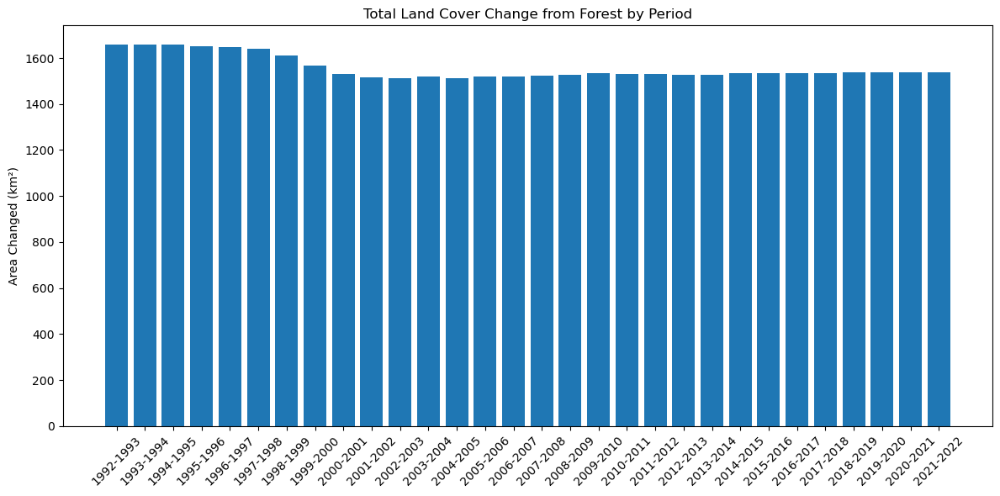

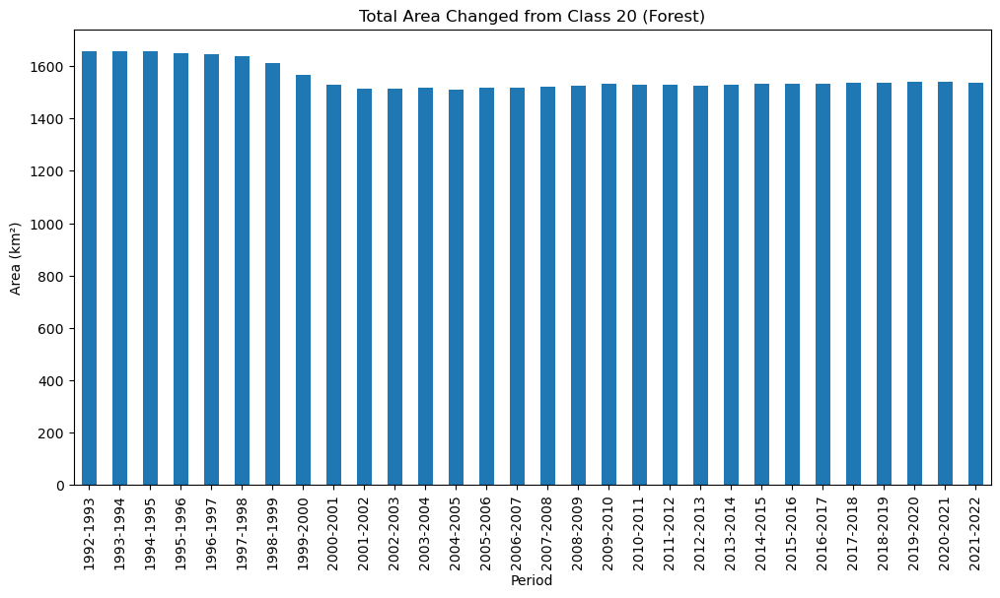

In [8]:
import grass.script as gs
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.ticker import FuncFormatter, StrMethodFormatter
from matplotlib.patches import Patch
from textwrap import wrap
# Compute total area changed from Forest (class 20) per period
period_totals = forest_transitions.groupby('Period')['Area_km2'].sum().reset_index()

# Plot total change over time
plt.figure(figsize=(12, 6))
plt.bar(period_totals['Period'], period_totals['Area_km2'])
plt.title('Total Land Cover Change from Forest by Period')
plt.ylabel('Area Changed (km²)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot net change for specific class
class_of_interest = 20  # Forest
class_changes = full_df.groupby(['Period', 'From'])['Area_km2'].sum().unstack()
class_changes[class_of_interest].plot(
    kind='bar', 
    figsize=(12, 6),
    title=f'Total Area Changed from Class {class_of_interest} (Forest)'
)
plt.ylabel('Area (km²)')
plt.show()



Persistence (no change) by class:


From
8     69511.23
20    46504.89
7      4268.79
13     2301.93
12      790.38
5       350.91
15      210.60
9         8.10
Name: Area_km2, dtype: float64

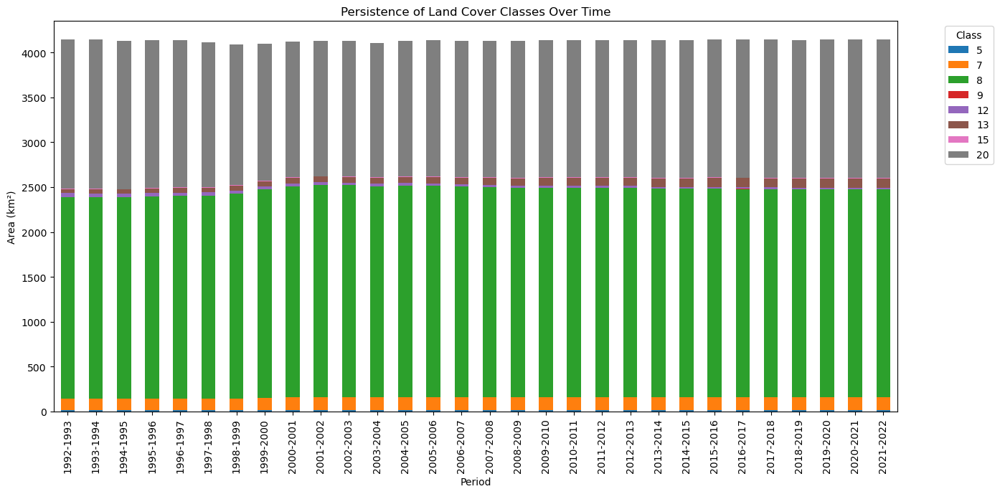

In [9]:
# Calculate persistence (when From == To)
persistence = full_df[full_df['From'] == full_df['To']]
print("\nPersistence (no change) by class:")
persistence_stats = persistence.groupby('From')['Area_km2'].sum().sort_values(ascending=False)
display(persistence_stats)

# Plot persistence over time
persistence.groupby(['Period', 'From'])['Area_km2'].sum().unstack().plot(
    kind='bar', 
    stacked=True,
    figsize=(14, 7),
    title='Persistence of Land Cover Classes Over Time'
)
plt.ylabel('Area (km²)')
plt.legend(title='Class', bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

In [10]:
# Calculate transition probabilities
transition_prob = transition_matrix.div(transition_matrix.sum(axis=1), axis=0)
print("\nTransition probabilities:")
display(transition_prob)


Transition probabilities:


To,5,7,8,9,12,13,15,20
From,,,,,,,,
5,0.998975,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.001025
7,0.000000,0.999536,0.000000,0.0,0.000000,0.000000,0.0,0.000464
8,0.000000,0.000000,0.998327,0.0,0.000000,0.000492,0.0,0.001180
9,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.0,0.000000
12,0.000000,0.000000,0.000000,0.0,0.968888,0.031112,0.0,0.000000
13,0.000000,0.000000,0.000000,0.0,0.000000,1.000000,0.0,0.000000
15,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,1.0,0.000000
20,0.000002,0.000393,0.003944,0.0,0.000013,0.000004,0.0,0.995643


In [11]:
from sklearn.preprocessing import normalize

# Normalize the transition matrix
markov_matrix = normalize(transition_matrix, norm='l1', axis=1)
print("\nMarkov transition matrix:")
display(pd.DataFrame(markov_matrix, 
                    index=transition_matrix.index, 
                    columns=transition_matrix.columns))


Markov transition matrix:


To,5,7,8,9,12,13,15,20
From,,,,,,,,
5,0.998975,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.001025
7,0.000000,0.999536,0.000000,0.0,0.000000,0.000000,0.0,0.000464
8,0.000000,0.000000,0.998327,0.0,0.000000,0.000492,0.0,0.001180
9,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.0,0.000000
12,0.000000,0.000000,0.000000,0.0,0.968888,0.031112,0.0,0.000000
13,0.000000,0.000000,0.000000,0.0,0.000000,1.000000,0.0,0.000000
15,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,1.0,0.000000
20,0.000002,0.000393,0.003944,0.0,0.000013,0.000004,0.0,0.995643


In [12]:
# Identify most dynamic classes
class_activity = full_df.groupby('From')['Area_km2'].sum().sort_values(ascending=False)
print("\nMost dynamic classes:")
display(class_activity)

# Identify stable classes
stable_classes = persistence_stats[persistence_stats > 1e6]  # Adjust threshold as needed
print("\nMost stable classes:")
display(stable_classes)


Most dynamic classes:


From
8     69627.69
20    46708.38
7      4270.77
13     2301.93
12      815.76
5       351.27
15      210.60
9         8.10
Name: Area_km2, dtype: float64


Most stable classes:


Series([], Name: Area_km2, dtype: float64)

In [14]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import colorsys
from plotly.subplots import make_subplots

# Load your land cover data
df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv')

# Define your land cover classes and colors
landcover_classes = {
    5: 'Shrubland', 
    7: 'Grassland', 
    8: 'Cropland', 
    9: 'Wetland',
    11: 'Lichens/Mosses', 
    12: 'Bareland', 
    13: 'Built-up', 
    15: 'Water',
    16: 'Ice/Snow', 
    20: 'Forest', 
    255: 'No Data'
}

landcover_colors = {
    'Shrubland': '#8C564B',
    'Grassland': '#FF7F0E',
    'Cropland': '#D62728',
    'Wetland': '#1F77B4',
    'Lichens/Mosses': '#9467BD',
    'Bareland': '#7F7F7F',
    'Built-up': '#BCBD22',
    'Water': '#17BECF',
    'Ice/Snow': '#AEC7E8',
    'Forest': '#2CA02C',
    'No Data': '#CCCCCC'
}

# Function to lighten colors
def lighten_hex_color(hex_color, factor=0.2):
    hex_color = hex_color.lstrip('#')
    r, g, b = tuple(int(hex_color[i:i+2], 16) for i in (0, 2, 4))  # fixed line
    h, l, s = colorsys.rgb_to_hls(r/255, g/255, b/255)
    l = min(1.0, l + factor)
    r, g, b = colorsys.hls_to_rgb(h, l, s)
    return '#%02x%02x%02x' % (int(r*255), int(g*255), int(b*255))

# Create transition matrix from your data
class_ids = sorted(df['From'].unique())
n_classes = len(class_ids)
transition_matrix = np.zeros((n_classes, n_classes))

for _, row in df.iterrows():
    from_idx = class_ids.index(row['From'])
    to_idx = class_ids.index(row['To'])
    transition_matrix[from_idx, to_idx] += row['Area_km2']

# Normalize for visualization
max_value = transition_matrix.max()
normalized_matrix = transition_matrix / max_value * 100

# Create combined figure with 2 rows
fig = make_subplots(
    rows=2, cols=1,
    vertical_spacing=0.15,
    subplot_titles=(
        "<b>Land Cover Transition Flows (Chord Diagram)</b>",
        "<b>Transition Statistics (Bar Chart)</b>"
    ),
    specs=[[{"type": "xy"}], [{"type": "xy"}]]
)

# 1. CHORD DIAGRAM (Top)
# Circular layout
theta = np.linspace(0, 2*np.pi, n_classes, endpoint=False)
radius = 1.5
node_x = radius * np.cos(theta)
node_y = radius * np.sin(theta)

# Add nodes
for i, class_id in enumerate(class_ids):
    class_name = landcover_classes[class_id]
    fig.add_trace(go.Scatter(
        x=[node_x[i]],
        y=[node_y[i]],
        mode='markers+text',
        marker=dict(
            size=transition_matrix[i,:].sum()/5000 + 20,
            color=landcover_colors[class_name],
            line=dict(width=2, color='white')
        ),
        text=[class_name],
        textposition='middle right' if node_x[i] > 0 else 'middle left',
        hoverinfo='text',
        hovertext=(
            f"<b>{class_name}</b><br>"
            f"Outflow: {transition_matrix[i,:].sum():,.0f} km²<br>"
            f"Inflow: {transition_matrix[:,i].sum():,.0f} km²"
        ),
        textfont=dict(size=12, color=landcover_colors[class_name]),
        showlegend=False
    ), row=1, col=1)

# Add connections
for i in range(n_classes):
    for j in range(n_classes):
        if transition_matrix[i,j] > 0:
            t = np.linspace(0, 1, 50)
            x = (1-t)**3 * node_x[i] + 3*(1-t)**2*t*(node_x[i]*0.7) + 3*(1-t)*t**2*(node_x[j]*0.7) + t**3*node_x[j]
            y = (1-t)**3 * node_y[i] + 3*(1-t)**2*t*(node_y[i]*0.7) + 3*(1-t)*t**2*(node_y[j]*0.7) + t**3*node_y[j]
            
            chord_color = lighten_hex_color(landcover_colors[landcover_classes[class_ids[i]]])
            
            fig.add_trace(go.Scatter(
                x=x,
                y=y,
                mode='lines',
                line=dict(
                    width=normalized_matrix[i,j]/3,
                    color=chord_color,
                    smoothing=1.3
                ),
                opacity=0.6,
                hoverinfo='text',
                hovertext=(
                    f"<b>From:</b> {landcover_classes[class_ids[i]]}<br>"
                    f"<b>To:</b> {landcover_classes[class_ids[j]]}<br>"
                    f"<b>Area:</b> {transition_matrix[i,j]:,.0f} km²<br>"
                    f"<b>Percentage:</b> {normalized_matrix[i,j]:.1f}%"
                ),
                showlegend=False
            ), row=1, col=1)

# 2. BAR PLOT (Bottom)
# Calculate statistics
total_outflow = transition_matrix.sum(axis=1)
total_inflow = transition_matrix.sum(axis=0)
mean_transition = np.mean(transition_matrix[transition_matrix > 0])

# Prepare data
landcover_stats = pd.DataFrame({
    'Land Cover': [landcover_classes[c] for c in class_ids],
    'Outflow': total_outflow,
    'Inflow': total_inflow,
    'Color': [landcover_colors[landcover_classes[c]] for c in class_ids]
}).sort_values('Outflow', ascending=False)

# Add bars
fig.add_trace(go.Bar(
    x=landcover_stats['Land Cover'],
    y=landcover_stats['Outflow'],
    name='Outflow',
    marker_color=landcover_stats['Color'],
    marker_line_color='white',
    marker_line_width=1.5,
    opacity=0.8,
    hoverinfo='y+text',
    hovertext=[f"Outflow: {val:,.0f} km²" for val in landcover_stats['Outflow']]
), row=2, col=1)

fig.add_trace(go.Bar(
    x=landcover_stats['Land Cover'],
    y=landcover_stats['Inflow'],
    name='Inflow',
    marker_color=[lighten_hex_color(c) for c in landcover_stats['Color']],
    marker_line_color='white',
    marker_line_width=1.5,
    opacity=0.6,
    hoverinfo='y+text',
    hovertext=[f"Inflow: {val:,.0f} km²" for val in landcover_stats['Inflow']]
), row=2, col=1)

# Update layout
fig.update_layout(
    height=1500,
    width=1200,
    plot_bgcolor='white',
    paper_bgcolor='white',
    hoverlabel=dict(
        bgcolor='white',
        font_size=12,
        font_family="Arial"
    ),
    xaxis1=dict(
        showgrid=False,
        zeroline=False,
        showticklabels=False
    ),
    yaxis1=dict(
        showgrid=False,
        zeroline=False,
        showticklabels=False
    ),
    xaxis2=dict(
        title='Land Cover Type',
        tickangle=45,
        tickfont=dict(size=10)
    ),
    yaxis2=dict(
        title='Area (km²)',
        tickformat=',.0f'
    ),
    margin=dict(t=100, b=100, l=50, r=50),
    barmode='group',
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

# Add annotations
fig.add_annotation(
    x=0.5, y=1.05,
    xref="paper", yref="paper",
    text=f"Mean Transition Area: {mean_transition:,.0f} km²",
    showarrow=False,
    font=dict(size=12, color="gray")
)

# Add color legend (for chord diagram)
for i, (class_id, class_name) in enumerate(landcover_classes.items()):
    fig.add_annotation(
        x=-1.8 if i < len(landcover_classes)//2 else 1.8,
        y=1.8 - (i % (len(landcover_classes)//2))*0.2,
        xref="x1", yref="y1",
        text=class_name,
        showarrow=False,
        font=dict(color=landcover_colors[class_name], size=10),
        align='left' if i >= len(landcover_classes)//2 else 'right'
    )

# Export as interactive HTML
fig.write_html(
    "/Users/ghulamabbaszafari/Desktop/ptof/landcover_side_by_side.html",
    config={
        'responsive': True,
        'scrollZoom': True,
        'displayModeBar': True,
        'displaylogo': False,
        'modeBarButtonsToRemove': ['lasso2d', 'select2d'],
        'toImageButtonOptions': {
            'format': 'png',
            'filename': 'landcover_analysis',
            'height': 1500,
            'width': 1200,
            'scale': 2
        }
    },
    include_plotlyjs='cdn',
    full_html=True,
    auto_open=False
)

print("Successfully exported to: /Users/ghulamabbaszafari/Desktop/ptof/landcover_side_by_side.html")

fig.show()



Successfully exported to: /Users/ghulamabbaszafari/Desktop/ptof/landcover_side_by_side.html


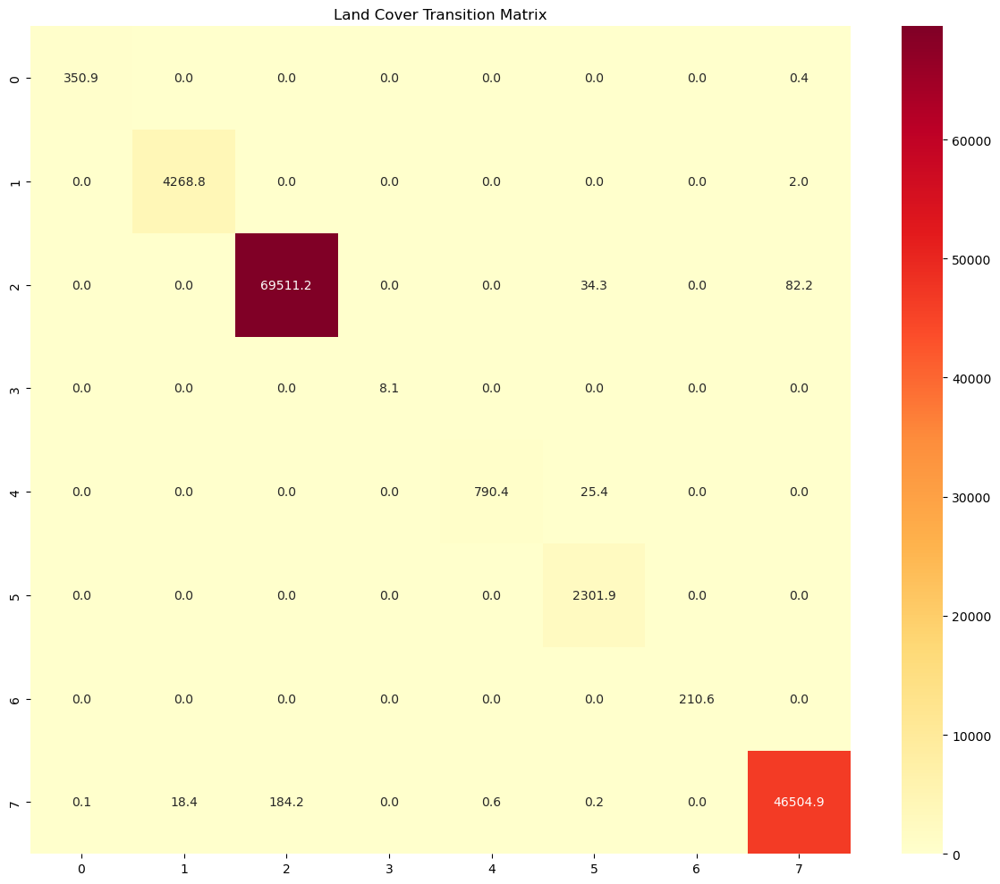

In [15]:
import seaborn as sns

plt.figure(figsize=(12, 10))
sns.heatmap(transition_matrix, cmap="YlOrRd", annot=True, fmt=".1f")
plt.title('Land Cover Transition Matrix')
plt.tight_layout()
plt.show()

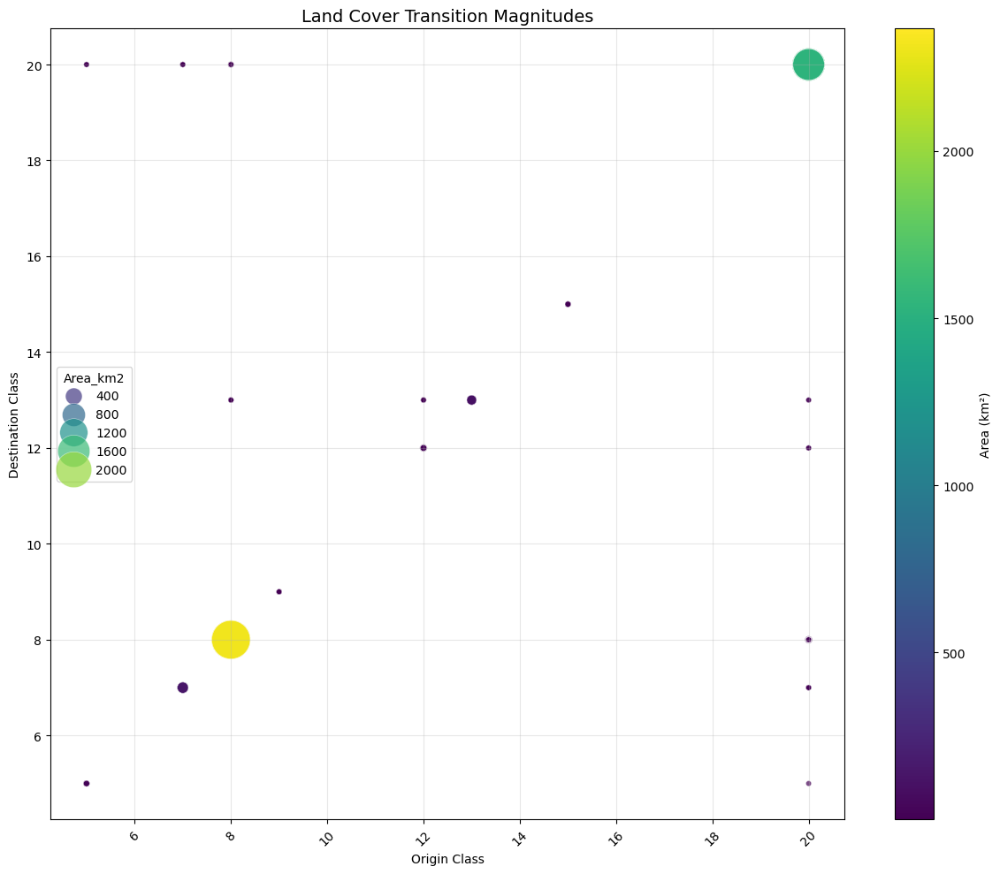

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your data
full_df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv')

# Create scatter plot
plt.figure(figsize=(12,10))
scatter = sns.scatterplot(
    data=full_df,
    x='From',
    y='To',
    size='Area_km2',
    hue='Area_km2',
    sizes=(20, 1000),
    palette='viridis',
    alpha=0.7,
    legend='brief'
)

# Titles and labels
plt.title("Land Cover Transition Magnitudes", fontsize=14)
plt.xlabel("Origin Class")
plt.ylabel("Destination Class")
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)

# Fix legend (colorbar-like effect)
norm = plt.Normalize(full_df['Area_km2'].min(), full_df['Area_km2'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('Area (km²)')

plt.tight_layout()
plt.show()


In [17]:
import pandas as pd
import plotly.express as px

# Load data
full_df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv')

# Land cover class labels and colors
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens and Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice & Snow', 20: 'Forest', 255: 'No Data'
}

class_colors = {
    'Shrubland': '#a65628',
    'Grassland': '#ff7f00',
    'Cropland': '#e41a1c',
    'Wetland': '#377eb8',
    'Lichens and Mosses': '#984ea3',
    'Bareland': '#999999',
    'Built-up': '#dede00',
    'Water': '#1f78b4',
    'Ice & Snow': '#a6cee3',
    'Forest': '#4daf4a',
    'No Data': '#cccccc'
}

# Summarize transitions
alluvial_df = full_df.groupby(['Period', 'From', 'To'])['Area_km2'].sum().reset_index()

# Map class labels to names
alluvial_df['From_Label'] = alluvial_df['From'].map(class_labels)
alluvial_df['To_Label'] = alluvial_df['To'].map(class_labels)

# Create a numeric ID for each class for color mapping
class_ids = {label: i for i, label in enumerate(class_labels.values())}
alluvial_df['Class_ID'] = alluvial_df['From_Label'].map(class_ids)

# Create custom color scale matching our class colors
color_scale = [[i/(len(class_colors)-1), color] for i, color in enumerate(class_colors.values())]

# Plot with correct color mapping
fig = px.parallel_categories(
    alluvial_df,
    dimensions=['From_Label', 'To_Label'],
    color='Class_ID',
    color_continuous_scale=color_scale,
    labels={'From_Label': 'Origin Class', 'To_Label': 'Destination Class'},
    width=1200,
    height=700,
    title="Land Cover Change Transitions"
)

# Update layout and colorbar
fig.update_layout(
    coloraxis_colorbar=dict(
        title='Land Cover Class',
        tickvals=list(range(len(class_colors))),
        ticktext=list(class_colors.keys())
    ),
    hovermode='closest',
    margin=dict(l=80, r=80, t=80, b=80)
)

# Only update the shape parameter
fig.update_traces(
    line_shape='hspline',  # Makes the connections curved
    arrangement='freeform'  # Allows categories to move freely
)

# Show plot
fig.show()




In [10]:
# Create a pivot table of transitions
transition_matrix = pd.pivot_table(alluvial_df, 
                                 values='Area_km2', 
                                 index='From_Label', 
                                 columns='To_Label',
                                 aggfunc='sum',
                                 fill_value=0)

# Add total columns
transition_matrix['Total_From'] = transition_matrix.sum(axis=1)
transition_matrix.loc['Total_To'] = transition_matrix.sum(axis=0)

# Display with styling
(transition_matrix
 .style
 .background_gradient(cmap='Blues')
 .format('{:,.0f} km²'))

To_Label,Bareland,Built-up,Cropland,Forest,Grassland,Shrubland,Water,Wetland,Total_From
From_Label,,,,,,,,,
Bareland,790 km²,25 km²,0 km²,0 km²,0 km²,0 km²,0 km²,0 km²,816 km²
Built-up,0 km²,"2,302 km²",0 km²,0 km²,0 km²,0 km²,0 km²,0 km²,"2,302 km²"
Cropland,0 km²,34 km²,"69,511 km²",82 km²,0 km²,0 km²,0 km²,0 km²,"69,628 km²"
Forest,1 km²,0 km²,184 km²,"46,505 km²",18 km²,0 km²,0 km²,0 km²,"46,708 km²"
Grassland,0 km²,0 km²,0 km²,2 km²,"4,269 km²",0 km²,0 km²,0 km²,"4,271 km²"
Shrubland,0 km²,0 km²,0 km²,0 km²,0 km²,351 km²,0 km²,0 km²,351 km²
Water,0 km²,0 km²,0 km²,0 km²,0 km²,0 km²,211 km²,0 km²,211 km²
Wetland,0 km²,0 km²,0 km²,0 km²,0 km²,0 km²,0 km²,8 km²,8 km²
Total_To,791 km²,"2,362 km²","69,695 km²","46,589 km²","4,287 km²",351 km²,211 km²,8 km²,"124,294 km²"


In [13]:
import pandas as pd
import plotly.express as px
import plotly.io as pio

# Force Plotly to show inline (in Jupyter Notebook)
pio.renderers.default = 'notebook'  # or use 'iframe_connected' in JupyterLab

# Assuming alluvial_df is already defined...
net_change = (
    alluvial_df.groupby('To_Label')['Area_km2'].sum() - 
    alluvial_df.groupby('From_Label')['Area_km2'].sum()
)

net_change = net_change.reset_index()
net_change.columns = ['Land_Cover_Class', 'Net_Change_km2']

# Plot bar chart of net changes
fig = px.bar(
    net_change, 
    x='Land_Cover_Class', 
    y='Net_Change_km2',
    title='Net Land Cover Change',
    color='Net_Change_km2',
    color_continuous_scale='RdYlGn'
)

fig.show()


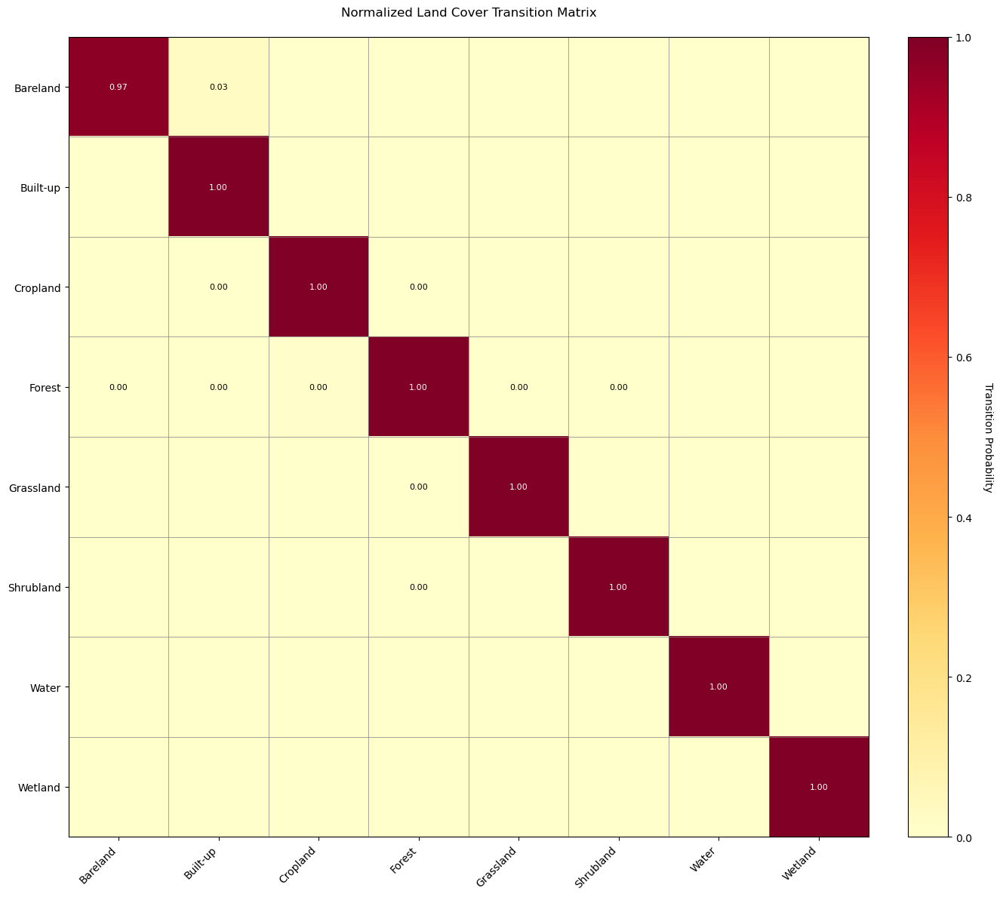

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load the CSV
df = pd.read_csv("/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv")

# Define class label mapping
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens and Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice & Snow', 20: 'Forest', 255: 'No Data'
}

# Map numeric codes to human-readable labels
df['From_Label'] = df['From'].map(class_labels)
df['To_Label'] = df['To'].map(class_labels)

# Drop rows where mapping failed (e.g., unknown land cover class)
df.dropna(subset=['From_Label', 'To_Label'], inplace=True)

# Create full transition matrix
transition_matrix = pd.crosstab(
    index=df['From_Label'],
    columns=df['To_Label'],
    values=df['Area_km2'],
    aggfunc='sum'
).fillna(0)

# Normalize by row (percentage transitions FROM each class)
normalized_matrix = transition_matrix.div(transition_matrix.sum(axis=1), axis=0)

# Plot heatmap
plt.figure(figsize=(14, 12))
ax = plt.gca()
im = ax.imshow(normalized_matrix, cmap='YlOrRd', vmin=0, vmax=1)

# Add colorbar
cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Transition Probability', rotation=270, labelpad=20)

# Set ticks and labels
ax.set_xticks(np.arange(len(normalized_matrix.columns)))
ax.set_yticks(np.arange(len(normalized_matrix.index)))
ax.set_xticklabels(normalized_matrix.columns, rotation=45, ha="right")
ax.set_yticklabels(normalized_matrix.index)

# Add annotations to cells
for i in range(len(normalized_matrix.index)):
    for j in range(len(normalized_matrix.columns)):
        value = normalized_matrix.iloc[i, j]
        if value > 0:
            text_color = "black" if value < 0.5 else "white"
            ax.text(j, i, f"{value:.2f}", ha="center", va="center", color=text_color, fontsize=8)

# Add minor grid
ax.set_xticks(np.arange(len(normalized_matrix.columns)+1)-.5, minor=True)
ax.set_yticks(np.arange(len(normalized_matrix.index)+1)-.5, minor=True)
ax.grid(which="minor", color="gray", linestyle='-', linewidth=0.5)
ax.tick_params(which="minor", size=0)

# Add title
plt.title('Normalized Land Cover Transition Matrix', pad=20)
plt.tight_layout()

# Save and show plot
plt.savefig('transition_heatmap.png', dpi=300, bbox_inches='tight')
plt.show()




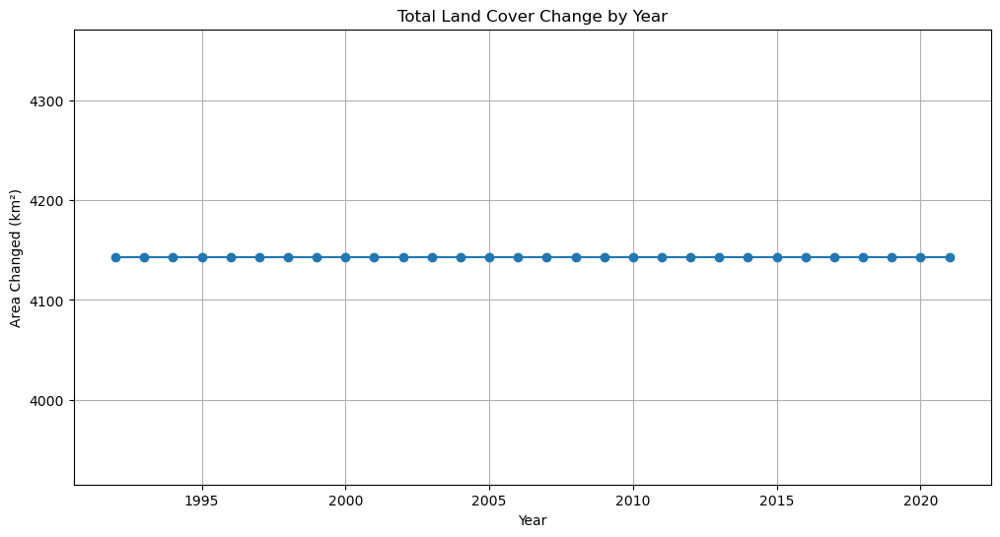

In [16]:
# Annual change analysis
annual_change = df.groupby('Period')['Area_km2'].sum().reset_index()
annual_change['Year'] = annual_change['Period'].str[:4].astype(int)

# Plot change over time
plt.figure(figsize=(12,6))
plt.plot(annual_change['Year'], annual_change['Area_km2'], marker='o')
plt.title('Total Land Cover Change by Year')
plt.xlabel('Year')
plt.ylabel('Area Changed (km²)')
plt.grid(True)
plt.savefig('annual_change.png', dpi=300)


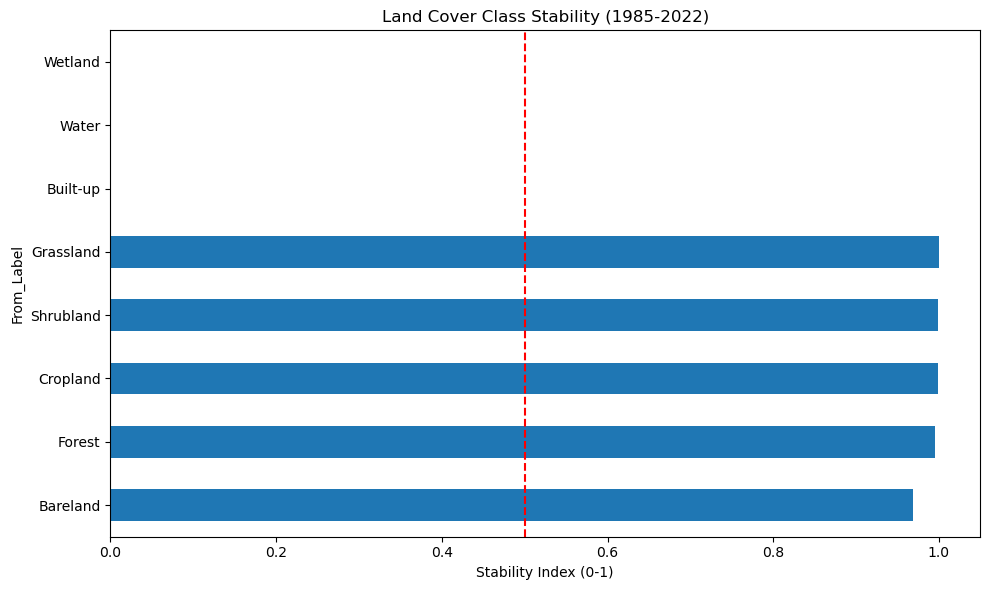

In [17]:
# Calculate persistence (same FROM and TO)
persistence = df[df['From'] == df['To']].groupby('From_Label')['Area_km2'].sum()
change = df[df['From'] != df['To']].groupby('From_Label')['Area_km2'].sum()

stability = (persistence / (persistence + change)).sort_values()

# Plot stability index
stability.plot(kind='barh', figsize=(10,6))
plt.title('Land Cover Class Stability (1985-2022)')
plt.xlabel('Stability Index (0-1)')
plt.axvline(0.5, color='red', linestyle='--')
plt.tight_layout()
plt.savefig('stability_index.png', dpi=300)



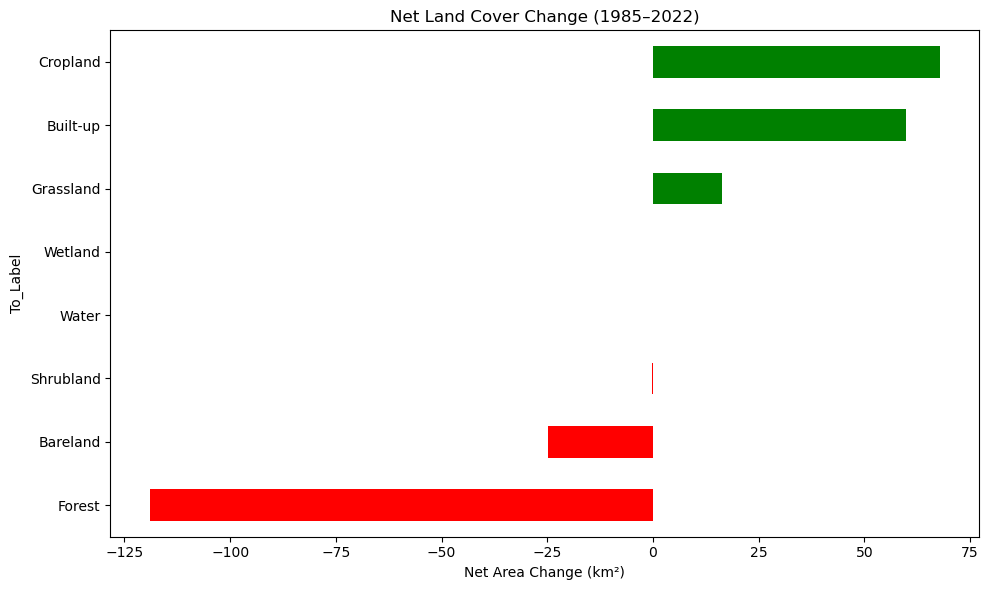

In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load your data
df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv')

# Define class label mapping
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens and Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice & Snow', 20: 'Forest', 255: 'No Data'
}

# Map numeric codes to labels
df['From_Label'] = df['From'].map(class_labels)
df['To_Label'] = df['To'].map(class_labels)

# Drop rows where mapping failed (unknown codes)
df.dropna(subset=['From_Label', 'To_Label'], inplace=True)

# Calculate net change for each class
to_sum = df.groupby('To_Label')['Area_km2'].sum()
from_sum = df.groupby('From_Label')['Area_km2'].sum()

# Align indexes (some labels may only appear in one of the two groupings)
net_change = to_sum.subtract(from_sum, fill_value=0)
net_change = net_change.sort_values()

# Plot net change
plt.figure(figsize=(10, 6))
net_change.plot(kind='barh', color=np.where(net_change > 0, 'green', 'red'))
plt.title('Net Land Cover Change (1985–2022)')
plt.xlabel('Net Area Change (km²)')
plt.tight_layout()
plt.savefig('net_change.png', dpi=300)
plt.show()




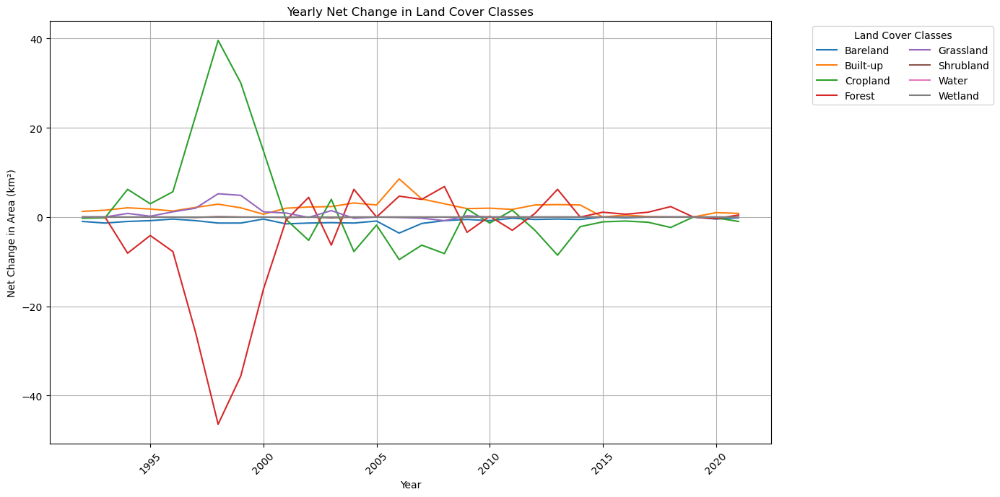

In [21]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict

# Load the CSV file
file_path = "/Users/ghulamabbaszafari/Desktop/tevere_basin_transitions.csv"
df = pd.read_csv(file_path)

# Define class label mapping
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens and Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice & Snow', 20: 'Forest', 255: 'No Data'
}

# Map From and To codes to readable labels
df['From_Label'] = df['From'].map(class_labels)
df['To_Label'] = df['To'].map(class_labels)

# Now drop rows with missing info
df = df.dropna(subset=['From_Label', 'To_Label', 'Area_km2', 'Period'])

# Prepare the dictionary for yearly changes
yearly_changes = defaultdict(lambda: defaultdict(float))

# Loop through each row to populate yearly_changes
for _, row in df.iterrows():
    period = row['Period']
    try:
        year = int(str(period).split("-")[0])  # Extract the 'from' year
    except:
        continue  # Skip rows with invalid year

    from_label = row['From_Label']
    to_label = row['To_Label']
    area = row['Area_km2']

    # Subtract area from the "from" class
    yearly_changes[year][from_label] -= area

    # Add area to the "to" class
    yearly_changes[year][to_label] += area

# Define the plotting function
def plot_yearly_changes(yearly_changes):
    plt.figure(figsize=(14, 7))

    # Extract unique land cover classes from all years
    all_classes = set()
    for year_dict in yearly_changes.values():
        all_classes.update(year_dict.keys())
    all_classes = sorted(all_classes)

    years = sorted(yearly_changes.keys())

    # Plot each class
    for land_cover_class in all_classes:
        changes = [yearly_changes[year].get(land_cover_class, 0) for year in years]
        plt.plot(years, changes, label=land_cover_class)

    plt.xlabel('Year')
    plt.ylabel('Net Change in Area (km²)')
    plt.title('Yearly Net Change in Land Cover Classes')
    plt.legend(title="Land Cover Classes", bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Call the function
plot_yearly_changes(yearly_changes)




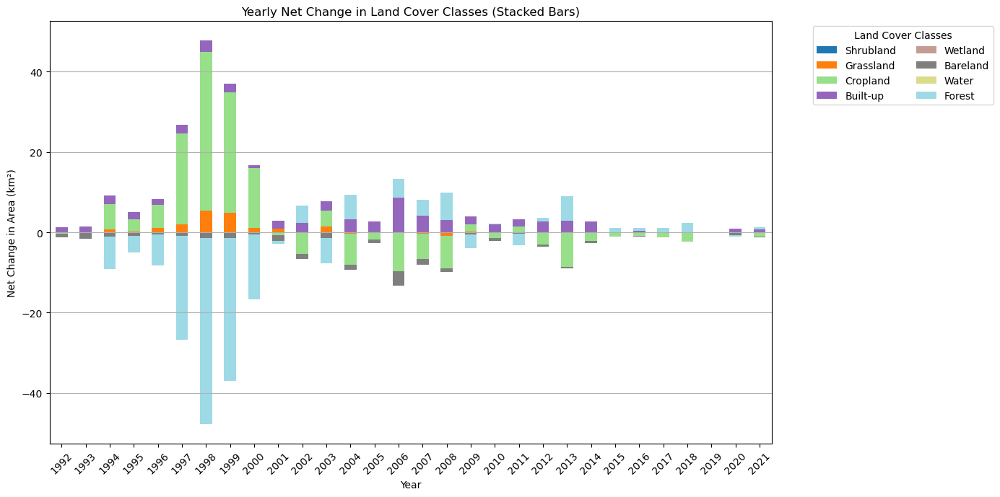

In [22]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_yearly_changes_bars(yearly_changes):
    # Convert yearly_changes dictionary to DataFrame
    df_changes = pd.DataFrame(yearly_changes).T.fillna(0).sort_index()

    # Plot as stacked bar chart
    ax = df_changes.plot(kind='bar', stacked=True, figsize=(14, 7), colormap='tab20')

    plt.xlabel('Year')
    plt.ylabel('Net Change in Area (km²)')
    plt.title('Yearly Net Change in Land Cover Classes (Stacked Bars)')
    plt.legend(title='Land Cover Classes', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2)
    plt.xticks(rotation=45)
    plt.grid(True, axis='y')
    plt.tight_layout()
    plt.show()

# Call the function (assuming `yearly_changes` is already built as shown earlier)
plot_yearly_changes_bars(yearly_changes)
